<a href="https://colab.research.google.com/github/agpascoe/NN_experiments/blob/main/PyTorhc/GAN_MNIST_Class.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [29]:
import torch, pdb
from torch.utils.data import DataLoader
from torch import nn
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from tqdm.auto import tqdm
import matplotlib.pyplot as plt


In [30]:
torch.__version__

'1.12.1+cu113'

In [31]:
#this is a visualization function
def show_images(input, channel=1, size=(28,28), sizegrid=6):
  #The imput is a vector of (samples, size), that is a comprossed nxn image (784 in this example)
  data = input.detach().cpu().view(-1, channel, *size) # move from (samples,nxn) vector to a (samples, 1, n, n) and move it to a CPU
  grid = make_grid(tensor=data[:sizegrid**2], nrow=sizegrid, padding=False).permute(1,2,0) # create a sizegrid x sizegrid grid ready for being plot (permute)
 
  print(data.shape, grid.shape)
  plt.imshow(grid)
  plt.show()



In [32]:



# HyperParameters
EPOCHS = 500
INFO_STEP = 500
ZDIM = 64
LR = 1e-5
BATCHSIZE = 128
DEVICE = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
DATALOADER = DataLoader(MNIST('.', download=True, transform=transforms.ToTensor()), shuffle=True, batch_size=BATCHSIZE)


torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


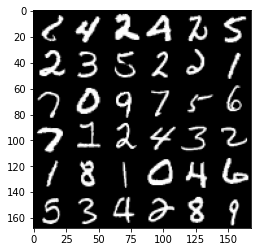

In [33]:
x, y = next(iter(DATALOADER))
show_images(x.view(-1,784))

In [34]:
#Noise generator
def noiseGenerator(nVectors, zDim):
  return torch.randn(nVectors, zDim).to(DEVICE)


In [35]:
from torch.nn.modules.activation import ReLU
#defining two models, Generator and Discriinator

def generatorBlock(input, output):
  return nn.Sequential(
      nn.Linear(input, output),
      nn.BatchNorm1d(output),
      nn.ReLU(inplace=True) #optimize memory because makes the operation directly
  )

class generatorClass(nn.Module):
  def __init__(self, zDim, hiddenDim, outputDim):
    super().__init__()
    self.gen = nn.Sequential(
        generatorBlock(zDim, hiddenDim),
        generatorBlock(hiddenDim, 2*hiddenDim),
        generatorBlock(2*hiddenDim, 4*hiddenDim),
        generatorBlock(4*hiddenDim, 8*hiddenDim),
        nn.Linear(8*hiddenDim, outputDim),
        nn.Sigmoid(),
    )
    self.optimizer = torch.optim.Adam(self.parameters(), lr = LR)
  
  def forward(self, noise):
    return self.gen(noise)


def discriminatorBlock(input, output):
  return nn.Sequential(
      nn.Linear(input, output),
      nn.LeakyReLU(0.02) #The size of the slope is 0.2
  )

class discriminatorClass(nn.Module):
  def __init__(self,inputDim):
    super().__init__()
    self.disc = nn.Sequential(
        discriminatorBlock(inputDim, int(inputDim/2)),
        discriminatorBlock(int(inputDim/2), int(inputDim/4)),
        discriminatorBlock(int(inputDim/4), int(inputDim/8)),
        nn.Linear(int(inputDim/8),1)
    )
    self.optimizer = torch.optim.Adam(self.parameters(), lr = LR)


  def forward(self, image):
    return self.disc(image)


In [36]:
#defining a GAN
class ganClass(nn.Module):
  def __init__(self, zDim, hiddenGenDim, inputDiscDim):
    super().__init__()
    self.generator = generatorClass(zDim, hiddenGenDim, inputDiscDim)
    self.discriminator = discriminatorClass(inputDiscDim)
    self.lossFunction = nn.BCEWithLogitsLoss()

  def forward(self, noise):
    return self.discriminator(self.generator(noise))

  def lossGenCalculation(self, number, zDim):
    preds = self.discriminator(self.generator(noiseGenerator(number, zDim)))
    return self.lossFunction(preds, torch.ones_like(preds).to(DEVICE))
  
  def lossDiscCalculation(self, number, zDim, real):
    discFake = self.discriminator(self.generator(noiseGenerator(number, zDim)).detach())
    discFakeLoss = self.lossFunction(discFake, torch.zeros_like(discFake).to(DEVICE))
    discReal = self.discriminator(real)
    discRealLoss = self.lossFunction(discReal, torch.ones_like(discReal).to(DEVICE))
    return (discFakeLoss+discRealLoss)/2

  def fit(self, zDim, dataloader=DATALOADER, epochs = EPOCHS):
    
    #Setup main parameters
    currentStep = 0
    currentBatchSize = 0
    meanGeneratorLoss = 0
    meanDiscrtiminatorLoss = 0

    
    for epoch in range(epochs):
      for real, _ in tqdm(dataloader):
        #trainning discriminator
        real=real.to(DEVICE)
        self.discriminator.optimizer.zero_grad()
        currentBatchSize = len(real)
        real = real.view(currentBatchSize, -1) #resizes to 128 x xx for example
        discLoss = self.lossDiscCalculation(currentBatchSize, zDim, real)
        discLoss.backward(retain_graph=True)
        self.discriminator.optimizer.step()


        #trainning generator
        self.generator.optimizer.zero_grad()
        genLoss = self.lossGenCalculation(currentBatchSize,zDim)
        genLoss.backward(retain_graph=True)
        self.generator.optimizer.step()

        meanDiscrtiminatorLoss+= discLoss.item() / INFO_STEP
        meanGeneratorLoss += genLoss.item() / INFO_STEP
        if currentStep % INFO_STEP == 0 and currentStep>0:
          fake = self.generator(noiseGenerator(currentBatchSize, zDim))
          show_images(fake)
          print(f'{epoch}, step: {currentStep}, MeanDiscLoss: {meanDiscrtiminatorLoss}, GenDiscLoss: {meanGeneratorLoss}')
          meanGeneratorLoss, meanDiscrtiminatorLoss = 0,0
        currentStep+= 1  





  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


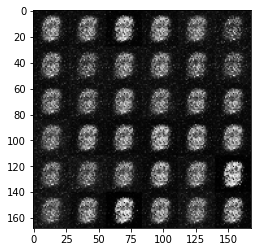

1, step: 500, MeanDiscLoss: 0.4730364393591884, GenDiscLoss: 1.0562829288244244


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


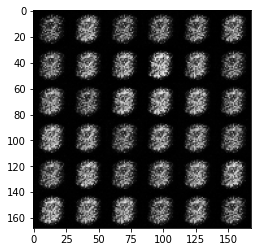

2, step: 1000, MeanDiscLoss: 0.41794812911748885, GenDiscLoss: 1.2336818716526021


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


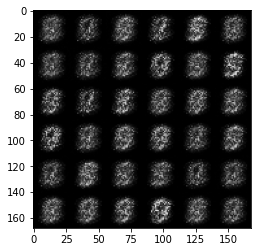

3, step: 1500, MeanDiscLoss: 0.3025228264033794, GenDiscLoss: 1.3743491706848148


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


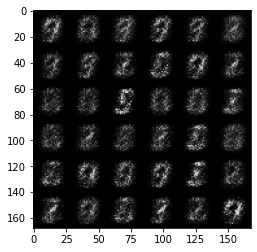

4, step: 2000, MeanDiscLoss: 0.2800807809531685, GenDiscLoss: 1.3297101395130153


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


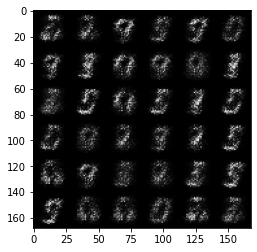

5, step: 2500, MeanDiscLoss: 0.2584967826604843, GenDiscLoss: 1.3639789395332342


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


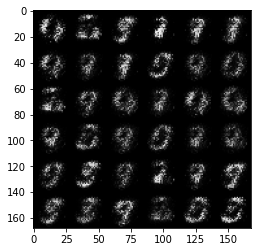

6, step: 3000, MeanDiscLoss: 0.18809221893548966, GenDiscLoss: 1.7387646465301498


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


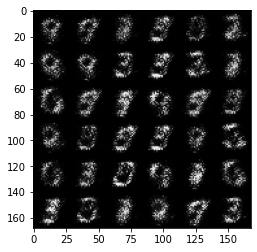

7, step: 3500, MeanDiscLoss: 0.13226725831627836, GenDiscLoss: 2.1896417164802533


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


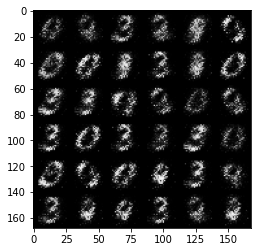

8, step: 4000, MeanDiscLoss: 0.11968903920054433, GenDiscLoss: 2.5678821649551384


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


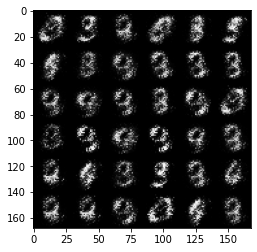

9, step: 4500, MeanDiscLoss: 0.10758505423367018, GenDiscLoss: 2.7848277626037583


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


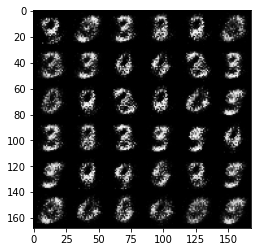

10, step: 5000, MeanDiscLoss: 0.08993694768100984, GenDiscLoss: 3.0968708634376556


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


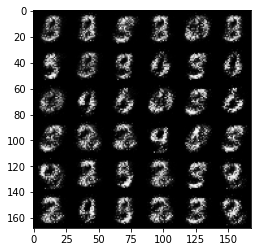

11, step: 5500, MeanDiscLoss: 0.0971248370707036, GenDiscLoss: 3.1375875229835506


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


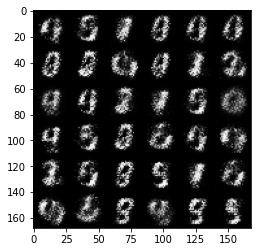

12, step: 6000, MeanDiscLoss: 0.09032196599990124, GenDiscLoss: 3.323967731952667


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


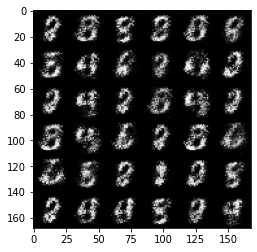

13, step: 6500, MeanDiscLoss: 0.08833446735143663, GenDiscLoss: 3.489047538280482


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


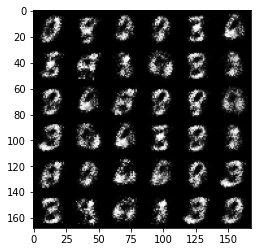

14, step: 7000, MeanDiscLoss: 0.07447320970892914, GenDiscLoss: 3.5368459935188348


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


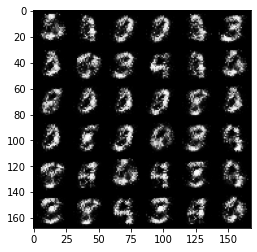

15, step: 7500, MeanDiscLoss: 0.07396519462019206, GenDiscLoss: 3.638006622314455


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


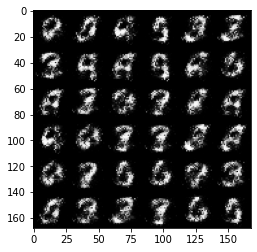

17, step: 8000, MeanDiscLoss: 0.07096216905117037, GenDiscLoss: 3.6709209718704234


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


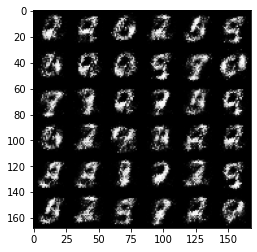

18, step: 8500, MeanDiscLoss: 0.06388685367256398, GenDiscLoss: 3.8208067431449866


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


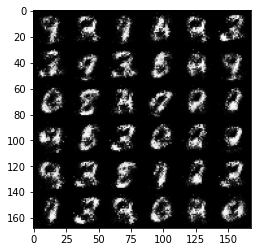

19, step: 9000, MeanDiscLoss: 0.07098812355846172, GenDiscLoss: 3.7118338875770553


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


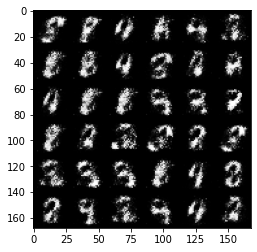

20, step: 9500, MeanDiscLoss: 0.06614811834692957, GenDiscLoss: 3.865473320484162


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


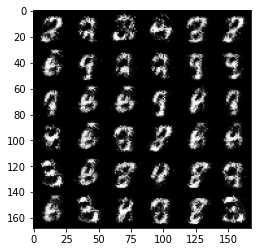

21, step: 10000, MeanDiscLoss: 0.06507908404618502, GenDiscLoss: 3.9148607158660886


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


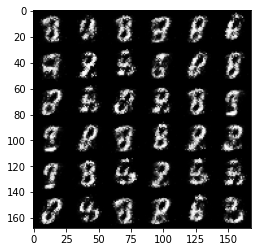

22, step: 10500, MeanDiscLoss: 0.08466757513582704, GenDiscLoss: 3.719441730022433


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


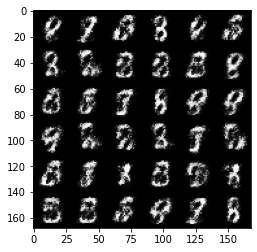

23, step: 11000, MeanDiscLoss: 0.09028686840832235, GenDiscLoss: 3.5758063659667947


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


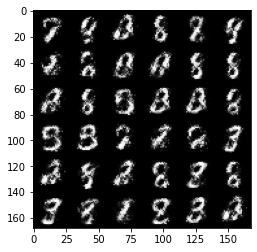

24, step: 11500, MeanDiscLoss: 0.09681332805007696, GenDiscLoss: 3.494817003726961


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


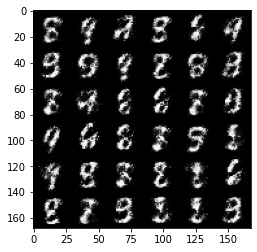

25, step: 12000, MeanDiscLoss: 0.08347846602648501, GenDiscLoss: 3.542559782981868


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


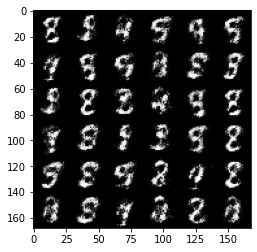

26, step: 12500, MeanDiscLoss: 0.09873239074647425, GenDiscLoss: 3.496481624126434


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


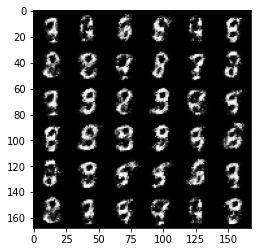

27, step: 13000, MeanDiscLoss: 0.09355071885883813, GenDiscLoss: 3.495888846397401


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


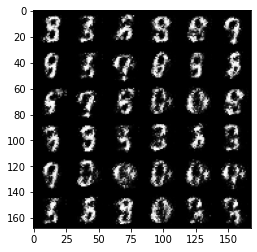

28, step: 13500, MeanDiscLoss: 0.09444757044315329, GenDiscLoss: 3.677400580883028


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


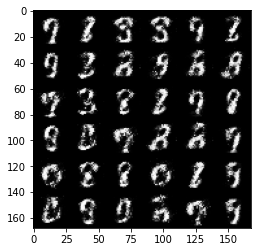

29, step: 14000, MeanDiscLoss: 0.10580512534826993, GenDiscLoss: 3.695286827087401


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


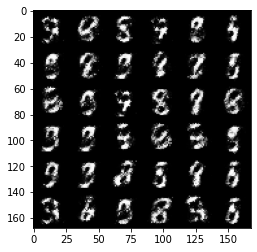

30, step: 14500, MeanDiscLoss: 0.11823214304447163, GenDiscLoss: 3.344601459980012


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


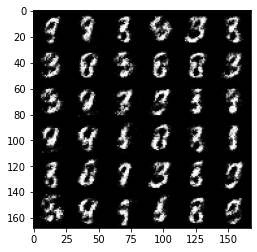

31, step: 15000, MeanDiscLoss: 0.10469057903438798, GenDiscLoss: 3.4990110511779786


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


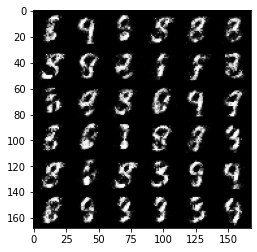

33, step: 15500, MeanDiscLoss: 0.11192318666726352, GenDiscLoss: 3.518904439449308


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


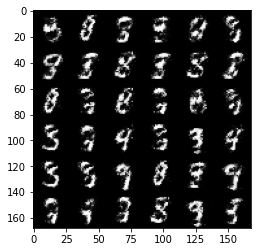

34, step: 16000, MeanDiscLoss: 0.11836129704117791, GenDiscLoss: 3.4468240652084368


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


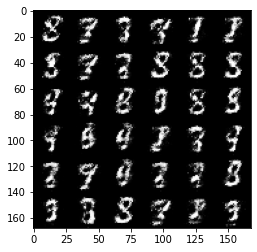

35, step: 16500, MeanDiscLoss: 0.1271219543814659, GenDiscLoss: 3.453050312519072


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


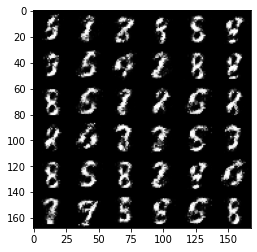

36, step: 17000, MeanDiscLoss: 0.11430318866670132, GenDiscLoss: 3.4679231925010696


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


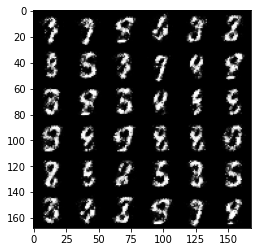

37, step: 17500, MeanDiscLoss: 0.11661354357749219, GenDiscLoss: 3.4799043145179778


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


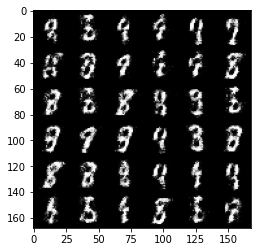

38, step: 18000, MeanDiscLoss: 0.1522370103597642, GenDiscLoss: 3.3563565855026267


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


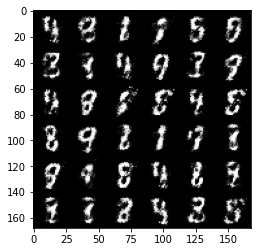

39, step: 18500, MeanDiscLoss: 0.16182420866191377, GenDiscLoss: 3.3387897868156413


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


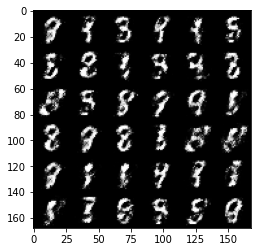

40, step: 19000, MeanDiscLoss: 0.1490325559824706, GenDiscLoss: 3.312222850799561


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


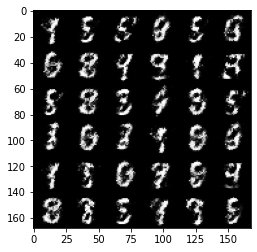

41, step: 19500, MeanDiscLoss: 0.14460099750757213, GenDiscLoss: 3.4507455911636327


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


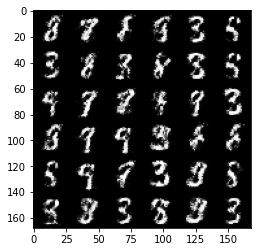

42, step: 20000, MeanDiscLoss: 0.17308634446561338, GenDiscLoss: 3.1966676201820388


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


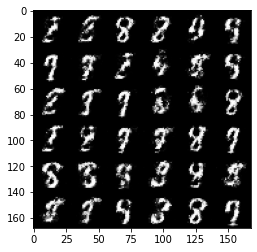

43, step: 20500, MeanDiscLoss: 0.17627715413272374, GenDiscLoss: 3.1190470552444456


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


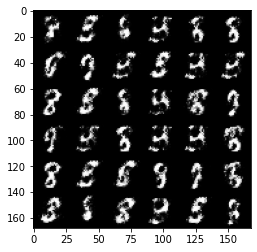

44, step: 21000, MeanDiscLoss: 0.16150129184126852, GenDiscLoss: 3.191156400680541


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


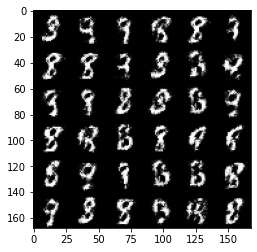

45, step: 21500, MeanDiscLoss: 0.17358602027595027, GenDiscLoss: 3.213877407073973


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


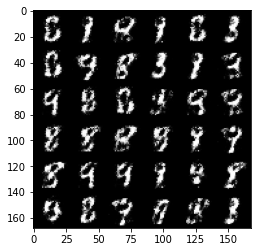

46, step: 22000, MeanDiscLoss: 0.1758367261141539, GenDiscLoss: 3.0601380605697615


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


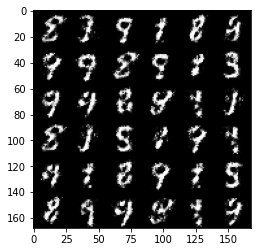

47, step: 22500, MeanDiscLoss: 0.18689954011142268, GenDiscLoss: 3.082635657787326


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


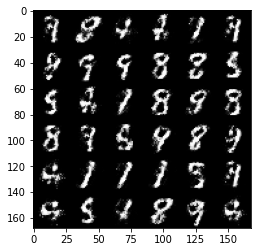

49, step: 23000, MeanDiscLoss: 0.16871195052564153, GenDiscLoss: 3.15354688358307


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


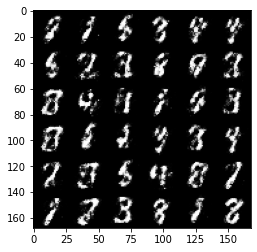

50, step: 23500, MeanDiscLoss: 0.17970154471695426, GenDiscLoss: 3.0019348773956325


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


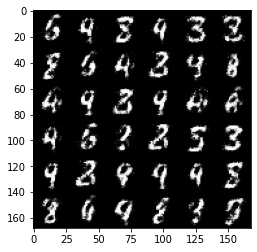

51, step: 24000, MeanDiscLoss: 0.17398528446257094, GenDiscLoss: 3.1130407085418708


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


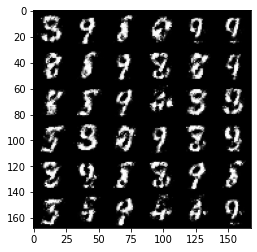

52, step: 24500, MeanDiscLoss: 0.17865656425058857, GenDiscLoss: 3.0574229302406306


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


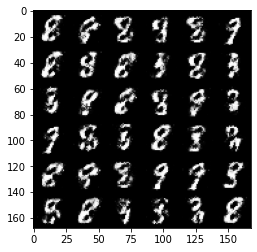

53, step: 25000, MeanDiscLoss: 0.1989035158157347, GenDiscLoss: 2.8418503150939953


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


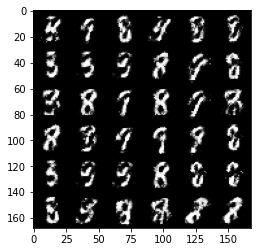

54, step: 25500, MeanDiscLoss: 0.18210607607662702, GenDiscLoss: 2.9081578726768478


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


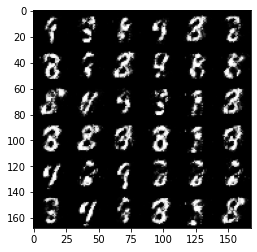

55, step: 26000, MeanDiscLoss: 0.1858487257361414, GenDiscLoss: 3.0084883265495304


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


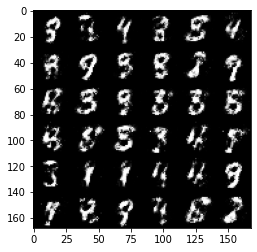

56, step: 26500, MeanDiscLoss: 0.19521905860304842, GenDiscLoss: 2.887202688694


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


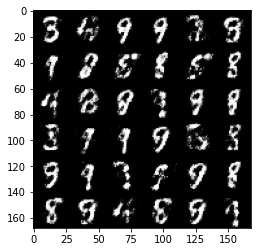

57, step: 27000, MeanDiscLoss: 0.22944122660160074, GenDiscLoss: 2.797538949012756


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


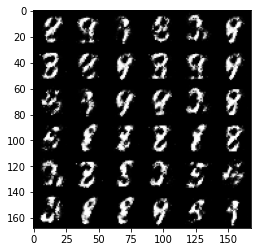

58, step: 27500, MeanDiscLoss: 0.226998613446951, GenDiscLoss: 2.698818034172057


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


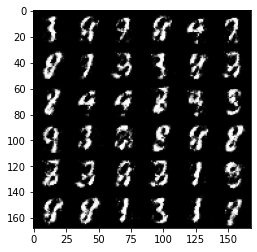

59, step: 28000, MeanDiscLoss: 0.21513709345459936, GenDiscLoss: 2.7326683125495896


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


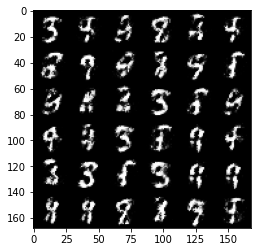

60, step: 28500, MeanDiscLoss: 0.22715301245450986, GenDiscLoss: 2.6253830785751373


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


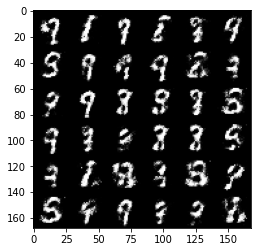

61, step: 29000, MeanDiscLoss: 0.19471190996468063, GenDiscLoss: 2.849260955810548


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


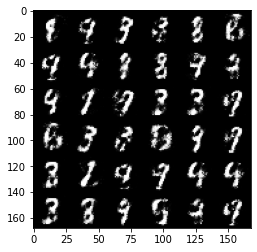

62, step: 29500, MeanDiscLoss: 0.21586052653193472, GenDiscLoss: 2.820151494979858


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


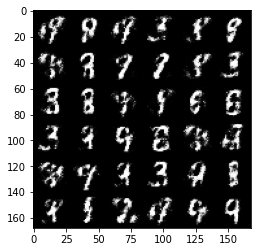

63, step: 30000, MeanDiscLoss: 0.24277395474910746, GenDiscLoss: 2.6476397862434387


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


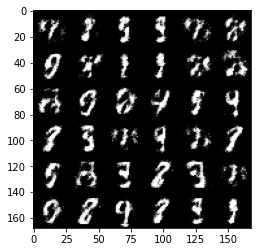

65, step: 30500, MeanDiscLoss: 0.23571721148490904, GenDiscLoss: 2.5967930207252503


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


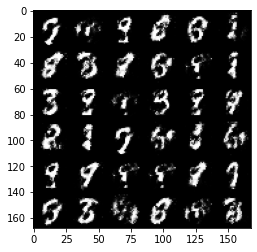

66, step: 31000, MeanDiscLoss: 0.2391850855350495, GenDiscLoss: 2.607656073331832


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


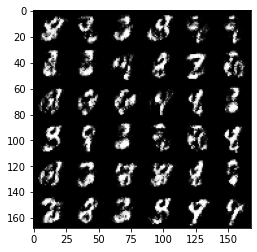

67, step: 31500, MeanDiscLoss: 0.24585906490683548, GenDiscLoss: 2.5130572328567484


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


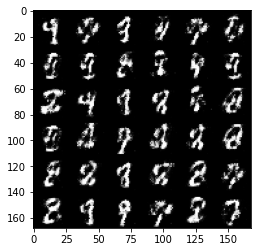

68, step: 32000, MeanDiscLoss: 0.2212518353611233, GenDiscLoss: 2.6640594372749296


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


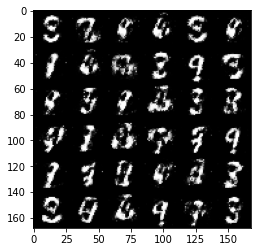

69, step: 32500, MeanDiscLoss: 0.24262186148762696, GenDiscLoss: 2.5618093500137338


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


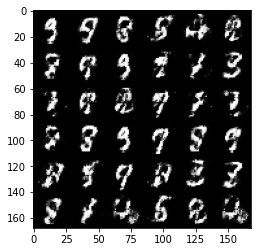

70, step: 33000, MeanDiscLoss: 0.26200468742847444, GenDiscLoss: 2.496377502441406


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


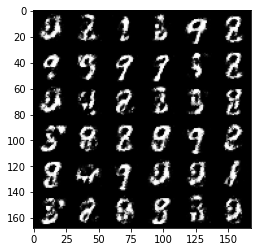

71, step: 33500, MeanDiscLoss: 0.2537856150567533, GenDiscLoss: 2.4406609148979173


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


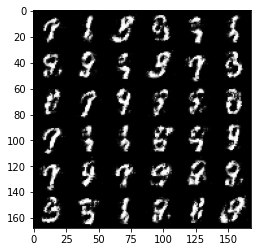

72, step: 34000, MeanDiscLoss: 0.22541382643580443, GenDiscLoss: 2.5488539977073663


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


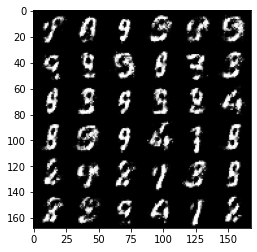

73, step: 34500, MeanDiscLoss: 0.23934238439798358, GenDiscLoss: 2.556132368564606


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


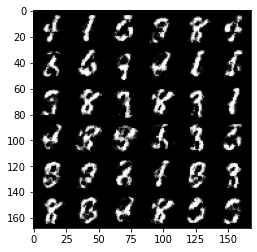

74, step: 35000, MeanDiscLoss: 0.28479757267236705, GenDiscLoss: 2.368275769710541


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


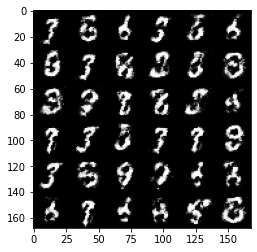

75, step: 35500, MeanDiscLoss: 0.2616579361855984, GenDiscLoss: 2.4286143219470997


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


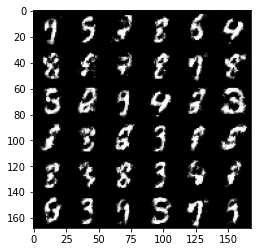

76, step: 36000, MeanDiscLoss: 0.24362177982926367, GenDiscLoss: 2.4776363372802734


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


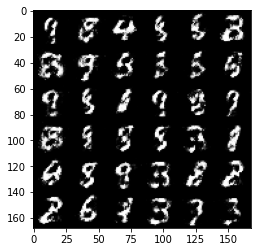

77, step: 36500, MeanDiscLoss: 0.24622152373194706, GenDiscLoss: 2.442076777458191


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


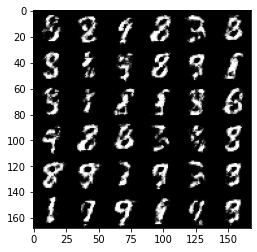

78, step: 37000, MeanDiscLoss: 0.2617363829910757, GenDiscLoss: 2.39420975446701


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


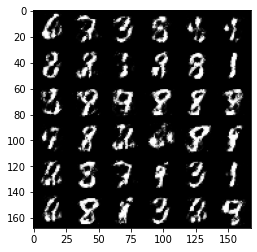

79, step: 37500, MeanDiscLoss: 0.273361910074949, GenDiscLoss: 2.3199172585010523


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


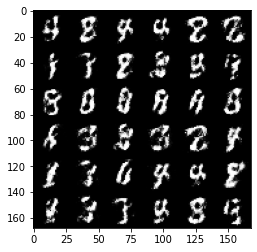

81, step: 38000, MeanDiscLoss: 0.2864946735799314, GenDiscLoss: 2.2356293621063204


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


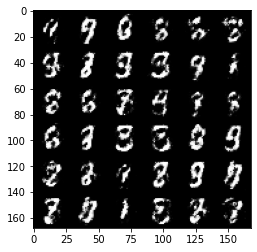

82, step: 38500, MeanDiscLoss: 0.2804473960101604, GenDiscLoss: 2.2419398663043966


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


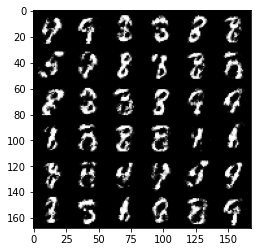

83, step: 39000, MeanDiscLoss: 0.2796265780329704, GenDiscLoss: 2.25400661444664


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


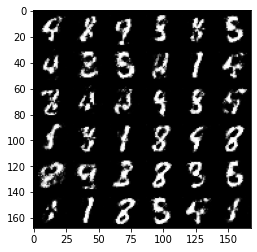

84, step: 39500, MeanDiscLoss: 0.27052080088853836, GenDiscLoss: 2.338114887714385


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


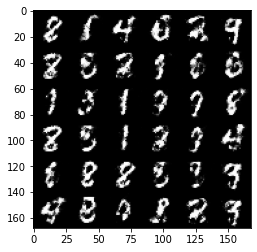

85, step: 40000, MeanDiscLoss: 0.29028357458114634, GenDiscLoss: 2.238692373752596


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


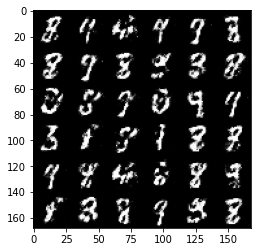

86, step: 40500, MeanDiscLoss: 0.2852231083214283, GenDiscLoss: 2.1980701580047612


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


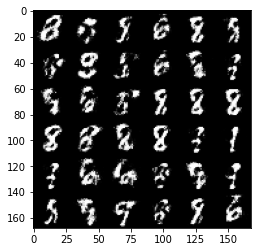

87, step: 41000, MeanDiscLoss: 0.2946426153779028, GenDiscLoss: 2.2399370870590203


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


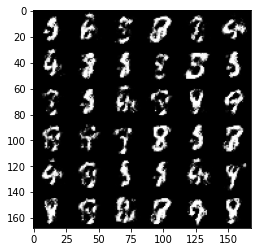

88, step: 41500, MeanDiscLoss: 0.2958664557635782, GenDiscLoss: 2.210636108398436


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


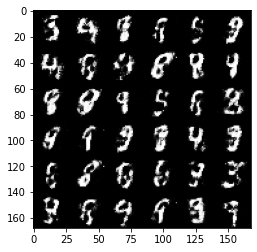

89, step: 42000, MeanDiscLoss: 0.2911009012758733, GenDiscLoss: 2.18618842411041


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


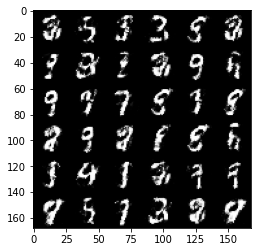

90, step: 42500, MeanDiscLoss: 0.2886873590946196, GenDiscLoss: 2.2054647045135516


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


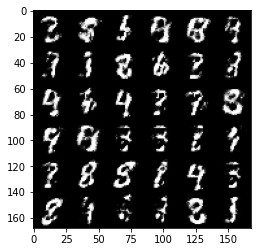

91, step: 43000, MeanDiscLoss: 0.2951299087107179, GenDiscLoss: 2.1957004194259606


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


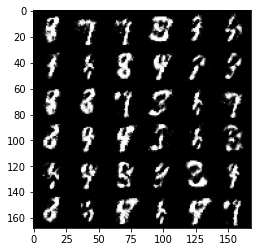

92, step: 43500, MeanDiscLoss: 0.30204589429497747, GenDiscLoss: 2.176958981275558


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


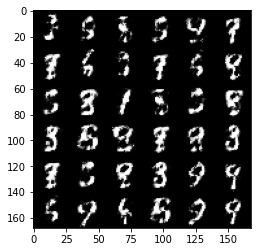

93, step: 44000, MeanDiscLoss: 0.2985537717342377, GenDiscLoss: 2.1661226673126217


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


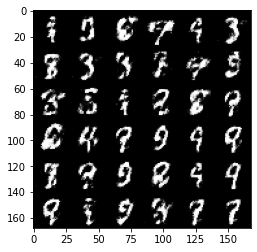

94, step: 44500, MeanDiscLoss: 0.29447242271900187, GenDiscLoss: 2.206201928138736


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


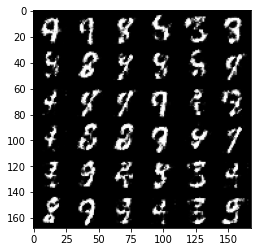

95, step: 45000, MeanDiscLoss: 0.29192412859201416, GenDiscLoss: 2.2246277875900273


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


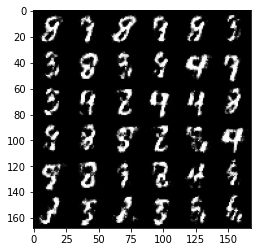

97, step: 45500, MeanDiscLoss: 0.32835615861415846, GenDiscLoss: 2.0591153857707973


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


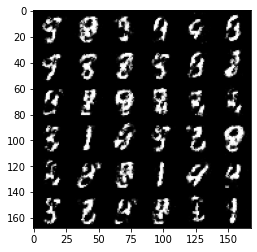

98, step: 46000, MeanDiscLoss: 0.3137487396299837, GenDiscLoss: 2.088738125324249


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


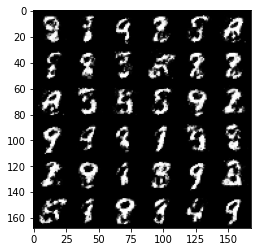

99, step: 46500, MeanDiscLoss: 0.3176047955751414, GenDiscLoss: 2.06618557858467


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


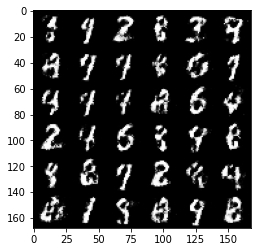

100, step: 47000, MeanDiscLoss: 0.32542467868328073, GenDiscLoss: 2.0554411137104043


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


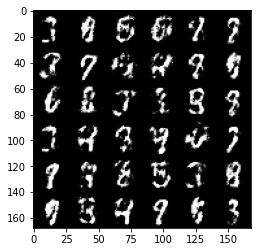

101, step: 47500, MeanDiscLoss: 0.32434812188148526, GenDiscLoss: 2.0507510626316057


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


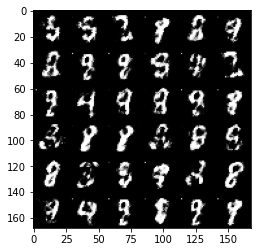

102, step: 48000, MeanDiscLoss: 0.29166970339417464, GenDiscLoss: 2.1746455733776093


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


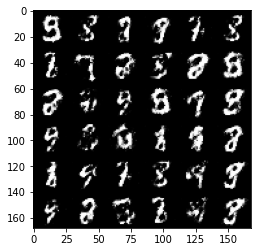

103, step: 48500, MeanDiscLoss: 0.31572964113950724, GenDiscLoss: 2.0853093042373656


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


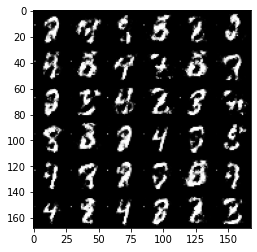

104, step: 49000, MeanDiscLoss: 0.3273127305805684, GenDiscLoss: 1.9388712718486785


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


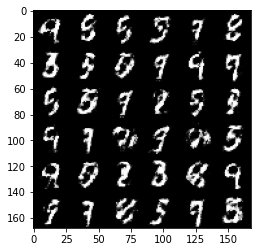

105, step: 49500, MeanDiscLoss: 0.3034687089025973, GenDiscLoss: 2.078675603389737


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


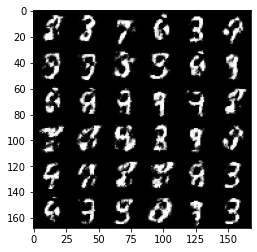

106, step: 50000, MeanDiscLoss: 0.3163985788226129, GenDiscLoss: 2.073547561645508


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


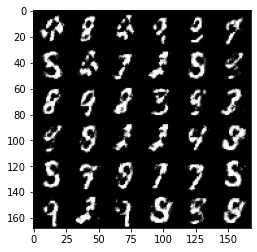

107, step: 50500, MeanDiscLoss: 0.31377788487076763, GenDiscLoss: 2.0195342073440554


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


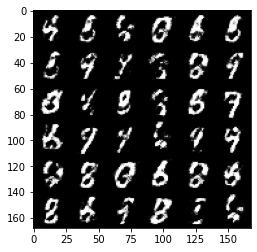

108, step: 51000, MeanDiscLoss: 0.31646891361475, GenDiscLoss: 2.044893757820129


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


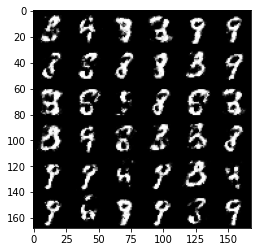

109, step: 51500, MeanDiscLoss: 0.32159408703446396, GenDiscLoss: 1.9989413576126092


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


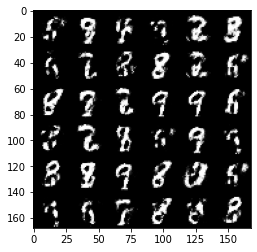

110, step: 52000, MeanDiscLoss: 0.33732284533977497, GenDiscLoss: 1.971430951595307


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


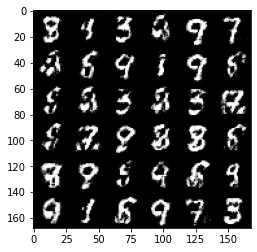

111, step: 52500, MeanDiscLoss: 0.3326101117730139, GenDiscLoss: 1.9343189673423782


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


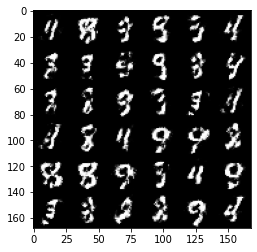

113, step: 53000, MeanDiscLoss: 0.31753523138165485, GenDiscLoss: 1.9922523365020746


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


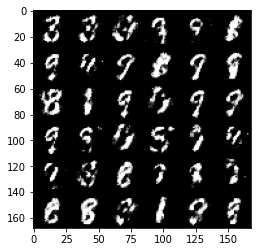

114, step: 53500, MeanDiscLoss: 0.3072138354182243, GenDiscLoss: 2.0786691117286704


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


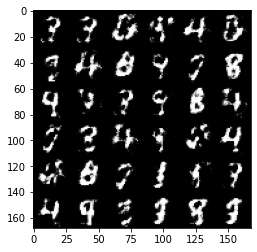

115, step: 54000, MeanDiscLoss: 0.3195393101274968, GenDiscLoss: 2.0133474986553215


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


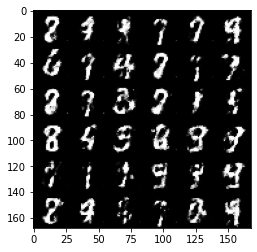

116, step: 54500, MeanDiscLoss: 0.3414451355040073, GenDiscLoss: 1.9408260169029237


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


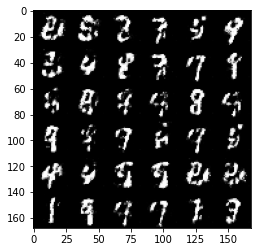

117, step: 55000, MeanDiscLoss: 0.33245220193266856, GenDiscLoss: 1.9513224873542803


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


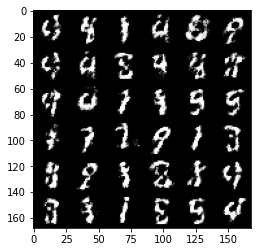

118, step: 55500, MeanDiscLoss: 0.3319034789204594, GenDiscLoss: 1.9378694534301761


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


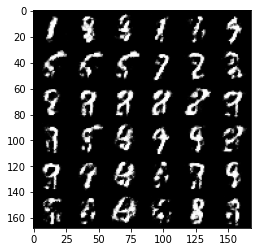

119, step: 56000, MeanDiscLoss: 0.331894939363003, GenDiscLoss: 1.9687347922325136


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


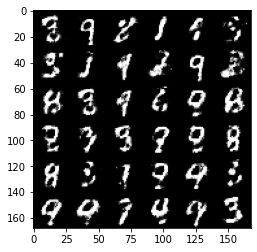

120, step: 56500, MeanDiscLoss: 0.3654926335811615, GenDiscLoss: 1.8042960989475234


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


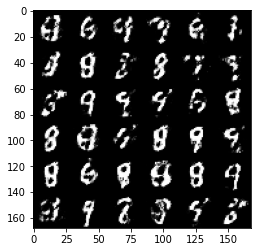

121, step: 57000, MeanDiscLoss: 0.33952918609976745, GenDiscLoss: 1.9168784525394469


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


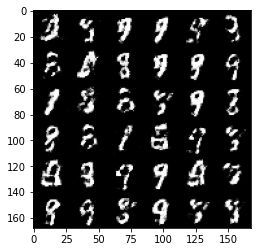

122, step: 57500, MeanDiscLoss: 0.339588707923889, GenDiscLoss: 1.8726516764163963


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


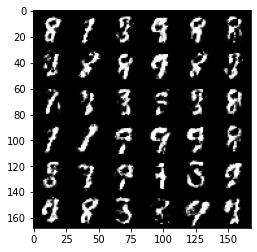

123, step: 58000, MeanDiscLoss: 0.33935053697228434, GenDiscLoss: 1.8872050209045421


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


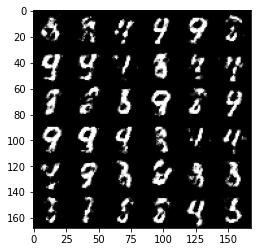

124, step: 58500, MeanDiscLoss: 0.34895818299055115, GenDiscLoss: 1.8760165607929218


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


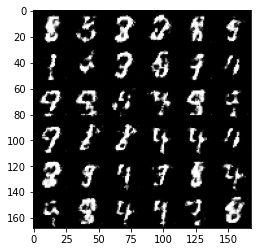

125, step: 59000, MeanDiscLoss: 0.3632577605843545, GenDiscLoss: 1.7979457318782788


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


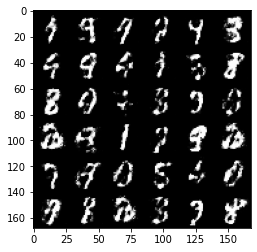

126, step: 59500, MeanDiscLoss: 0.3701842731833459, GenDiscLoss: 1.7835619375705702


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


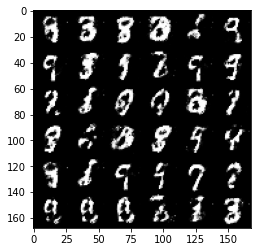

127, step: 60000, MeanDiscLoss: 0.3934617688059804, GenDiscLoss: 1.673051530122758


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([96, 1, 28, 28]) torch.Size([168, 168, 3])


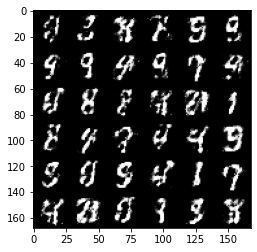

128, step: 60500, MeanDiscLoss: 0.38829037863016147, GenDiscLoss: 1.6844274559020995


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


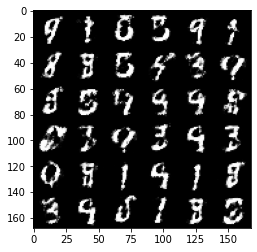

130, step: 61000, MeanDiscLoss: 0.36282510289549863, GenDiscLoss: 1.8156884453296642


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


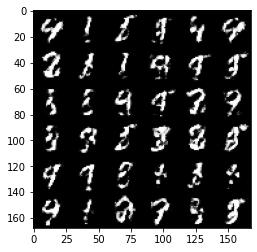

131, step: 61500, MeanDiscLoss: 0.3681371423602105, GenDiscLoss: 1.7481617217063898


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


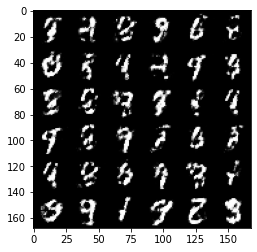

132, step: 62000, MeanDiscLoss: 0.36280220097303406, GenDiscLoss: 1.7429303903579696


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


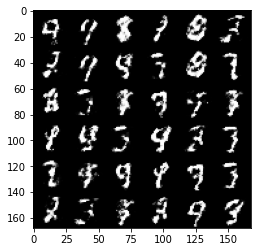

133, step: 62500, MeanDiscLoss: 0.37446626281738293, GenDiscLoss: 1.7349230306148524


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


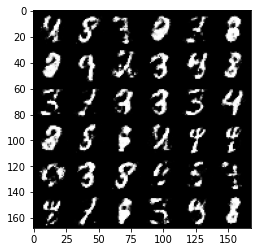

134, step: 63000, MeanDiscLoss: 0.368798264563084, GenDiscLoss: 1.6999563910961148


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


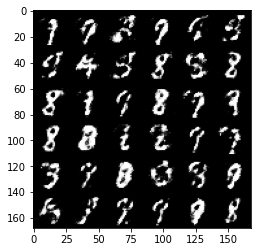

135, step: 63500, MeanDiscLoss: 0.3843135799169537, GenDiscLoss: 1.635554705142975


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


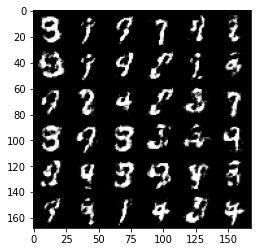

136, step: 64000, MeanDiscLoss: 0.3712226947546005, GenDiscLoss: 1.6984940314292916


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


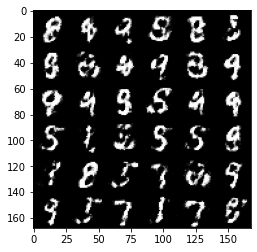

137, step: 64500, MeanDiscLoss: 0.4059456096291543, GenDiscLoss: 1.614071507453918


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


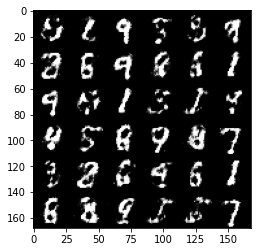

138, step: 65000, MeanDiscLoss: 0.40423756641149505, GenDiscLoss: 1.6251375265121457


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


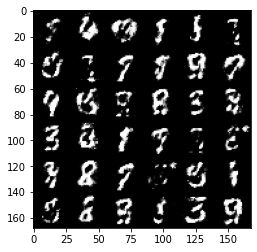

139, step: 65500, MeanDiscLoss: 0.4126784498691557, GenDiscLoss: 1.5776967217922193


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


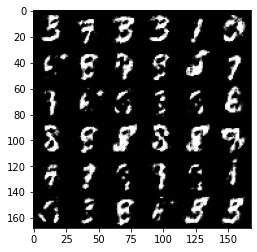

140, step: 66000, MeanDiscLoss: 0.421418462216854, GenDiscLoss: 1.54521482014656


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


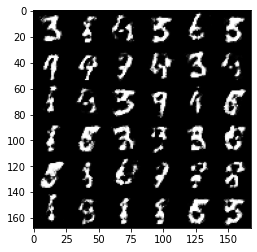

141, step: 66500, MeanDiscLoss: 0.4249418531656265, GenDiscLoss: 1.4857356281280527


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


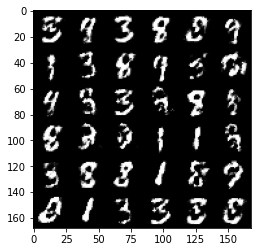

142, step: 67000, MeanDiscLoss: 0.4005811694264411, GenDiscLoss: 1.5725132770538344


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


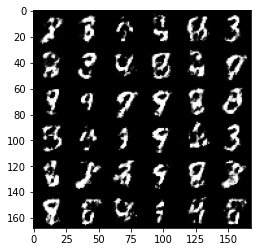

143, step: 67500, MeanDiscLoss: 0.4207789636254309, GenDiscLoss: 1.5145715849399564


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


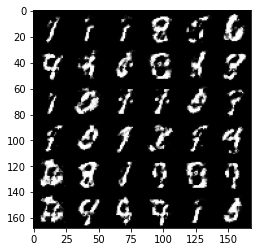

144, step: 68000, MeanDiscLoss: 0.41607634693384166, GenDiscLoss: 1.5492823972702026


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


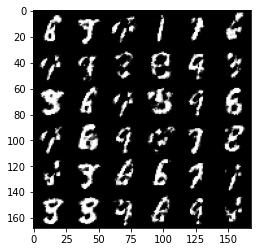

146, step: 68500, MeanDiscLoss: 0.3890812169313436, GenDiscLoss: 1.60944082760811


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


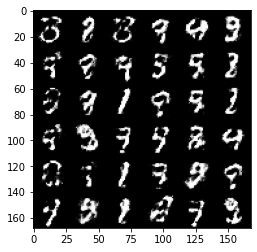

147, step: 69000, MeanDiscLoss: 0.4156602313518527, GenDiscLoss: 1.5326617078781115


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


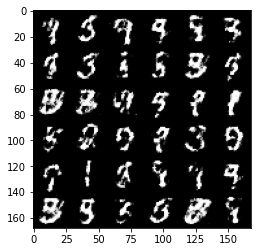

148, step: 69500, MeanDiscLoss: 0.42025953900814067, GenDiscLoss: 1.5380405080318453


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


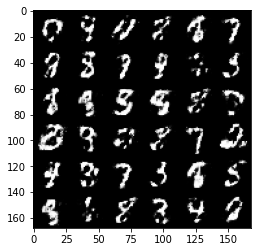

149, step: 70000, MeanDiscLoss: 0.4100191127061845, GenDiscLoss: 1.574016601085662


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


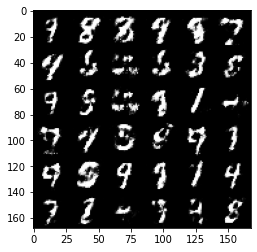

150, step: 70500, MeanDiscLoss: 0.45442311728000634, GenDiscLoss: 1.4796203598976134


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


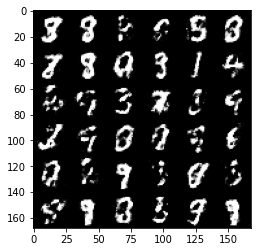

151, step: 71000, MeanDiscLoss: 0.43574220120906804, GenDiscLoss: 1.4908492991924287


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


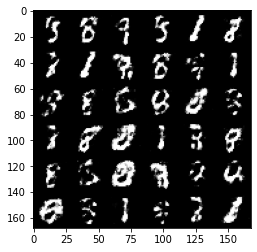

152, step: 71500, MeanDiscLoss: 0.4551872078776359, GenDiscLoss: 1.398953549146651


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


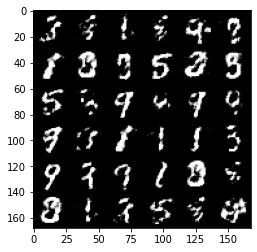

153, step: 72000, MeanDiscLoss: 0.41712287378311147, GenDiscLoss: 1.4873384232521059


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


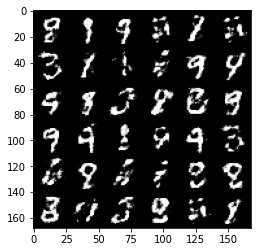

154, step: 72500, MeanDiscLoss: 0.444541115164757, GenDiscLoss: 1.4106387488842023


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


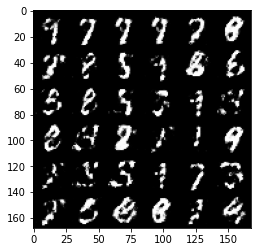

155, step: 73000, MeanDiscLoss: 0.4399532479047776, GenDiscLoss: 1.429255447149278


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


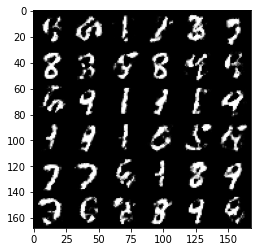

156, step: 73500, MeanDiscLoss: 0.46760987889766653, GenDiscLoss: 1.3727221112251278


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


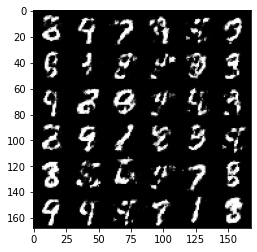

157, step: 74000, MeanDiscLoss: 0.46301514923572545, GenDiscLoss: 1.3713616545200364


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


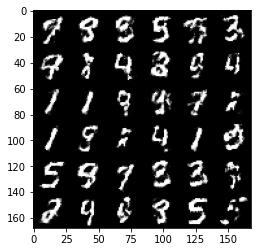

158, step: 74500, MeanDiscLoss: 0.478323117852211, GenDiscLoss: 1.3278904769420625


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


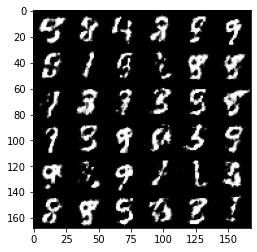

159, step: 75000, MeanDiscLoss: 0.46317589104175555, GenDiscLoss: 1.3660085799694066


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


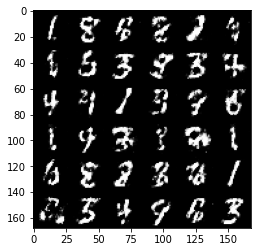

160, step: 75500, MeanDiscLoss: 0.4723169600367547, GenDiscLoss: 1.3071269228458402


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


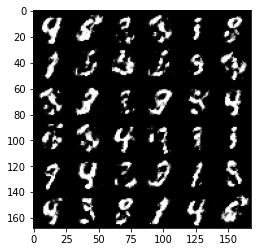

162, step: 76000, MeanDiscLoss: 0.4597515624165531, GenDiscLoss: 1.3915617957115183


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


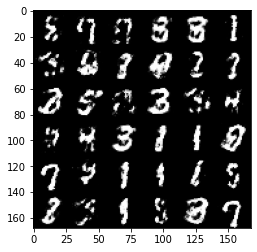

163, step: 76500, MeanDiscLoss: 0.4445972299575802, GenDiscLoss: 1.4374604909420012


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


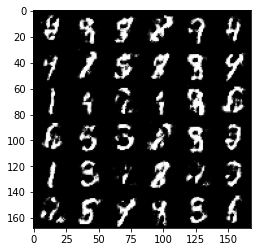

164, step: 77000, MeanDiscLoss: 0.45282501882314713, GenDiscLoss: 1.3800071778297438


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


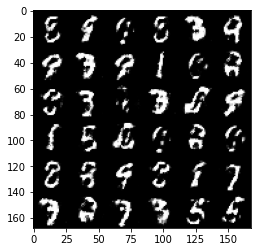

165, step: 77500, MeanDiscLoss: 0.4491324930787084, GenDiscLoss: 1.3924594085216537


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


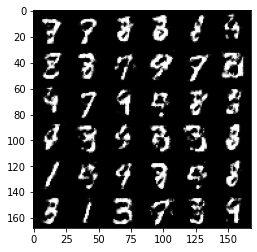

166, step: 78000, MeanDiscLoss: 0.43629751205444334, GenDiscLoss: 1.3950655655860902


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


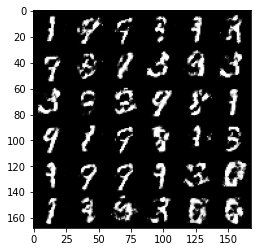

167, step: 78500, MeanDiscLoss: 0.4746280732750891, GenDiscLoss: 1.325477476835252


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


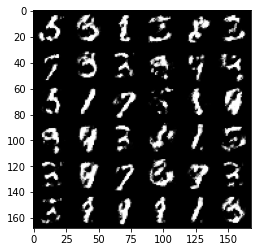

168, step: 79000, MeanDiscLoss: 0.47458038067817715, GenDiscLoss: 1.3110995841026323


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


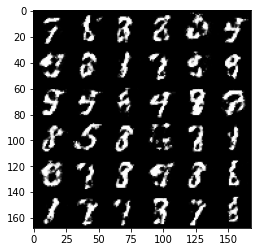

169, step: 79500, MeanDiscLoss: 0.4726260328888895, GenDiscLoss: 1.306339442253113


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


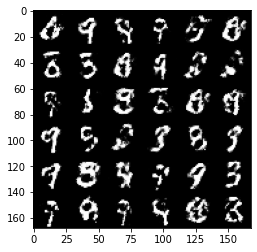

170, step: 80000, MeanDiscLoss: 0.459183663547039, GenDiscLoss: 1.346220689535141


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


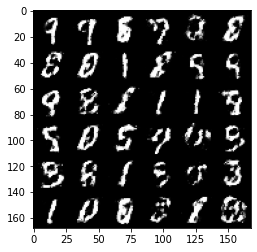

171, step: 80500, MeanDiscLoss: 0.4627322993278507, GenDiscLoss: 1.3362863712310793


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


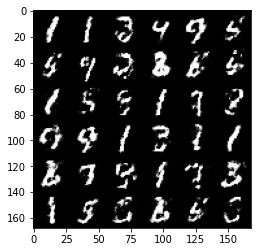

172, step: 81000, MeanDiscLoss: 0.4871582929491993, GenDiscLoss: 1.2475717051029214


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


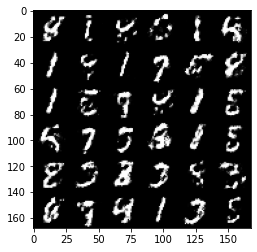

173, step: 81500, MeanDiscLoss: 0.4559618175625803, GenDiscLoss: 1.3498216714859006


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


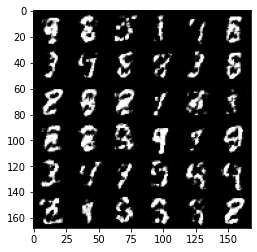

174, step: 82000, MeanDiscLoss: 0.47096918964386003, GenDiscLoss: 1.3086715941429137


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


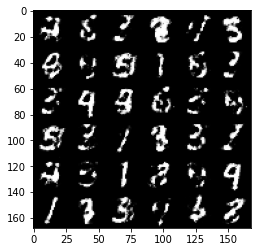

175, step: 82500, MeanDiscLoss: 0.4911193071007729, GenDiscLoss: 1.2492148762941357


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


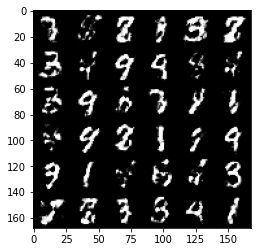

176, step: 83000, MeanDiscLoss: 0.4686767868995669, GenDiscLoss: 1.2832698235511784


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


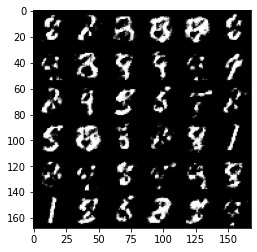

178, step: 83500, MeanDiscLoss: 0.5016834915876389, GenDiscLoss: 1.2152606036663058


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


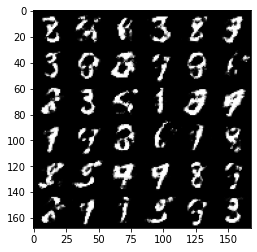

179, step: 84000, MeanDiscLoss: 0.48381175196170756, GenDiscLoss: 1.2395159974098207


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


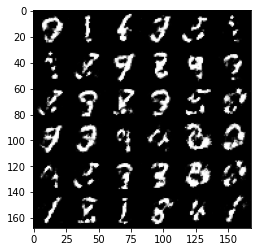

180, step: 84500, MeanDiscLoss: 0.4985553788542747, GenDiscLoss: 1.2089144949913024


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


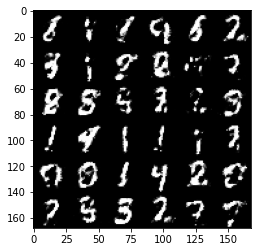

181, step: 85000, MeanDiscLoss: 0.49390764677524585, GenDiscLoss: 1.2398093469142917


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


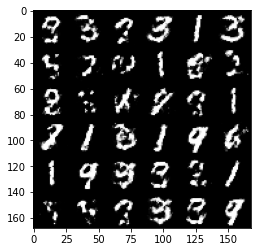

182, step: 85500, MeanDiscLoss: 0.5175726456046096, GenDiscLoss: 1.1862252385616294


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


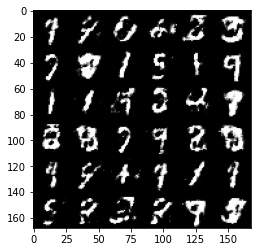

183, step: 86000, MeanDiscLoss: 0.5175971540212632, GenDiscLoss: 1.1894084377288823


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


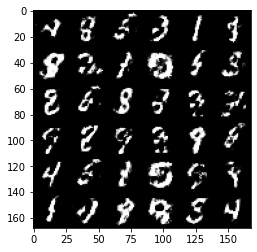

184, step: 86500, MeanDiscLoss: 0.4992190312743188, GenDiscLoss: 1.2005675408840173


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


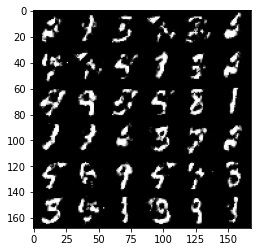

185, step: 87000, MeanDiscLoss: 0.49453628879785533, GenDiscLoss: 1.2184139053821568


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


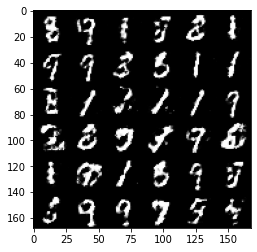

186, step: 87500, MeanDiscLoss: 0.5016436962485313, GenDiscLoss: 1.2090123312473302


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


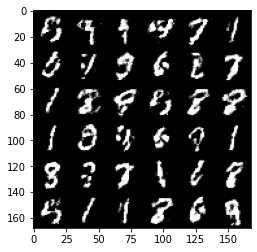

187, step: 88000, MeanDiscLoss: 0.4993243849277493, GenDiscLoss: 1.2160396707057948


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


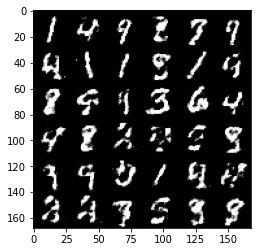

188, step: 88500, MeanDiscLoss: 0.5223185006976124, GenDiscLoss: 1.1605763030052176


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


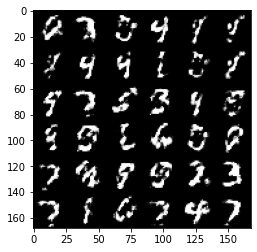

189, step: 89000, MeanDiscLoss: 0.5235481736660001, GenDiscLoss: 1.1483139120340342


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


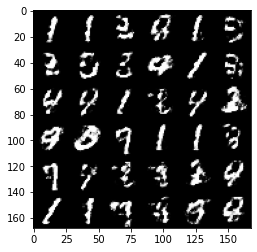

190, step: 89500, MeanDiscLoss: 0.49863722866773635, GenDiscLoss: 1.1725114567279817


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


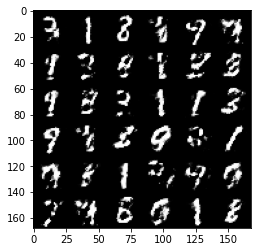

191, step: 90000, MeanDiscLoss: 0.4895208223462107, GenDiscLoss: 1.2360599024295813


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


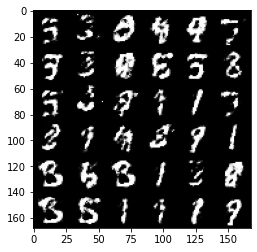

192, step: 90500, MeanDiscLoss: 0.49959472060203525, GenDiscLoss: 1.198244492292405


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


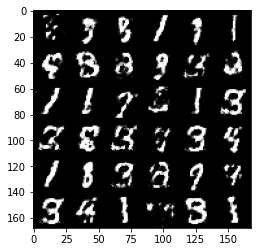

194, step: 91000, MeanDiscLoss: 0.5158407142162318, GenDiscLoss: 1.1756534101963045


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


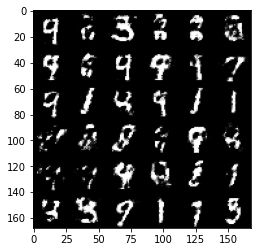

195, step: 91500, MeanDiscLoss: 0.5292607291340827, GenDiscLoss: 1.111714540123939


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


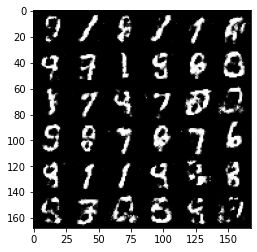

196, step: 92000, MeanDiscLoss: 0.5298650132417678, GenDiscLoss: 1.1248174476623538


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


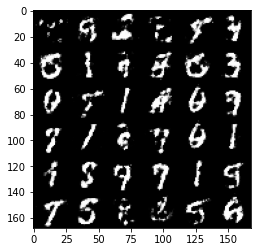

197, step: 92500, MeanDiscLoss: 0.5195707326531412, GenDiscLoss: 1.1454431035518648


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


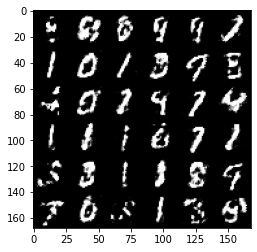

198, step: 93000, MeanDiscLoss: 0.5410633023381229, GenDiscLoss: 1.0921021096706378


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


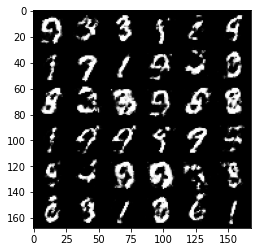

199, step: 93500, MeanDiscLoss: 0.54337427598238, GenDiscLoss: 1.0718505977392199


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


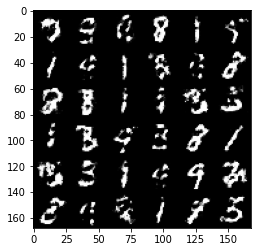

200, step: 94000, MeanDiscLoss: 0.522215849339962, GenDiscLoss: 1.072132971405983


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


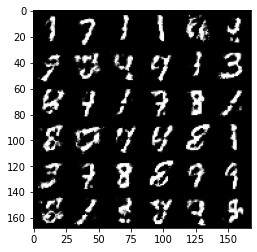

201, step: 94500, MeanDiscLoss: 0.5140180137157441, GenDiscLoss: 1.120582979917526


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


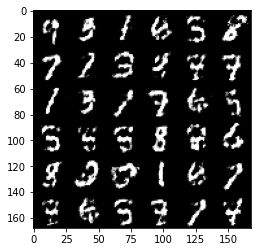

202, step: 95000, MeanDiscLoss: 0.5146007040739061, GenDiscLoss: 1.1496229753494263


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


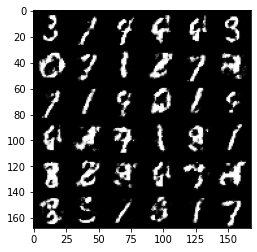

203, step: 95500, MeanDiscLoss: 0.5450392708182339, GenDiscLoss: 1.0674262932538978


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


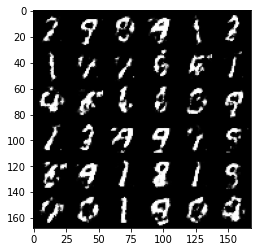

204, step: 96000, MeanDiscLoss: 0.5523896165490151, GenDiscLoss: 1.0302782884836195


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


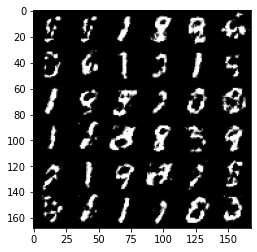

205, step: 96500, MeanDiscLoss: 0.5390244379043578, GenDiscLoss: 1.0406101766824725


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


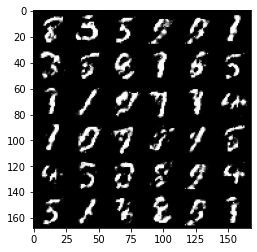

206, step: 97000, MeanDiscLoss: 0.5467657809853554, GenDiscLoss: 1.0403967958688731


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


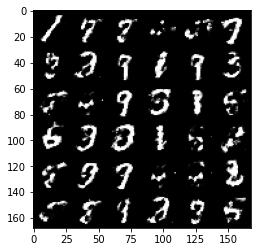

207, step: 97500, MeanDiscLoss: 0.5295324700474738, GenDiscLoss: 1.0756632833480841


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


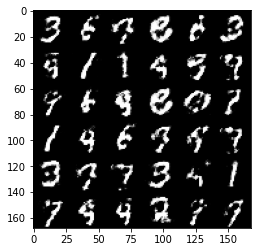

208, step: 98000, MeanDiscLoss: 0.5338406559228901, GenDiscLoss: 1.085371921658516


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


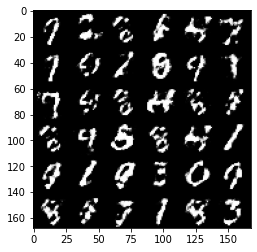

210, step: 98500, MeanDiscLoss: 0.5334485495686533, GenDiscLoss: 1.095269436717033


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


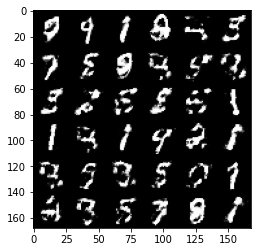

211, step: 99000, MeanDiscLoss: 0.5513491459488865, GenDiscLoss: 1.0322352048158645


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


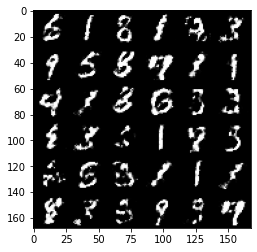

212, step: 99500, MeanDiscLoss: 0.5097091517448422, GenDiscLoss: 1.164548936605453


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


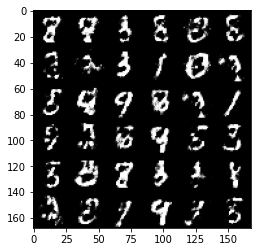

213, step: 100000, MeanDiscLoss: 0.5357437444925306, GenDiscLoss: 1.0622997688055038


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


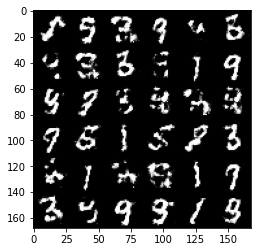

214, step: 100500, MeanDiscLoss: 0.532726797997951, GenDiscLoss: 1.0835983099937447


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


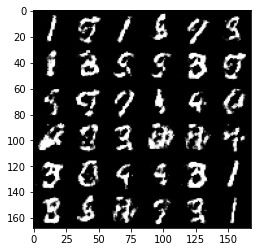

215, step: 101000, MeanDiscLoss: 0.5208872058987625, GenDiscLoss: 1.127034797072412


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


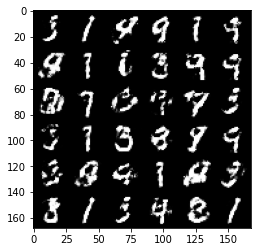

216, step: 101500, MeanDiscLoss: 0.522277517795563, GenDiscLoss: 1.133088002085686


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


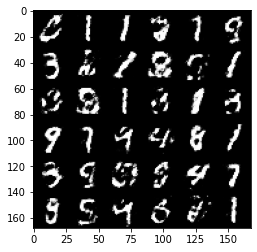

217, step: 102000, MeanDiscLoss: 0.5250198250412942, GenDiscLoss: 1.131861592531205


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


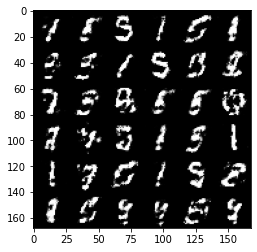

218, step: 102500, MeanDiscLoss: 0.5395676788091663, GenDiscLoss: 1.080903345942497


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


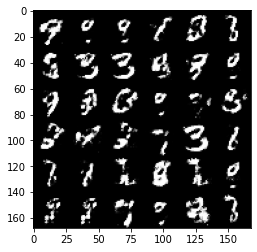

219, step: 103000, MeanDiscLoss: 0.5140883291363717, GenDiscLoss: 1.1159606041908257


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


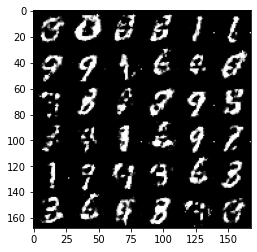

220, step: 103500, MeanDiscLoss: 0.568058097779751, GenDiscLoss: 1.0736178834438321


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


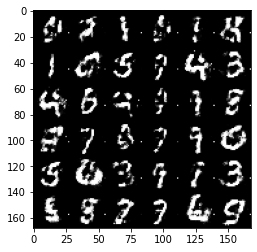

221, step: 104000, MeanDiscLoss: 0.6669702030420304, GenDiscLoss: 0.8051136693954469


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


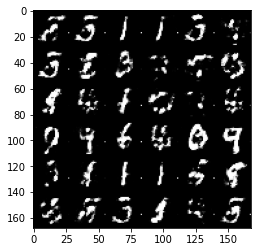

222, step: 104500, MeanDiscLoss: 0.48226175111532193, GenDiscLoss: 1.20071174287796


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


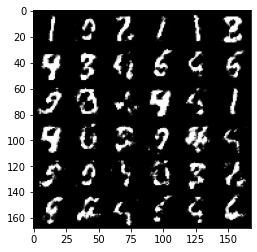

223, step: 105000, MeanDiscLoss: 0.48521847486495934, GenDiscLoss: 1.2116021859645851


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


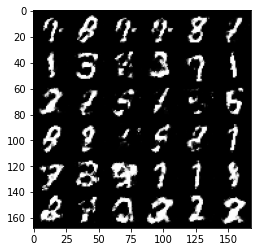

224, step: 105500, MeanDiscLoss: 0.4894644068479536, GenDiscLoss: 1.2103324899673442


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


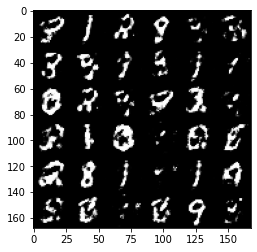

226, step: 106000, MeanDiscLoss: 0.4990396664142605, GenDiscLoss: 1.1454452615976336


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


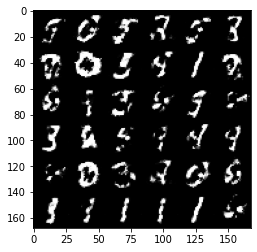

227, step: 106500, MeanDiscLoss: 0.5050946562290194, GenDiscLoss: 1.1148417916297912


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


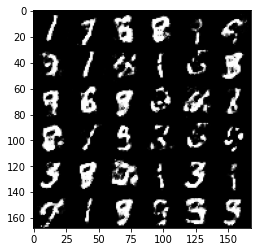

228, step: 107000, MeanDiscLoss: 0.5222400338053703, GenDiscLoss: 1.095683825373649


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


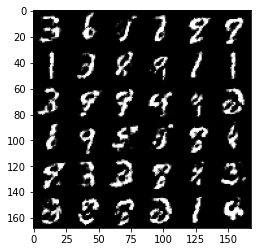

229, step: 107500, MeanDiscLoss: 0.49500648504495615, GenDiscLoss: 1.1354139600992201


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


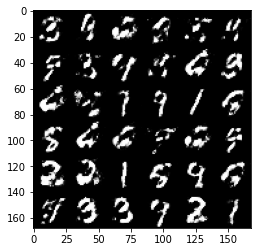

230, step: 108000, MeanDiscLoss: 0.5163538569808014, GenDiscLoss: 1.1524383270740497


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


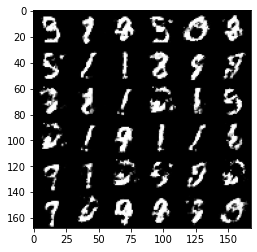

231, step: 108500, MeanDiscLoss: 0.5472801879644391, GenDiscLoss: 1.0880553164482107


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


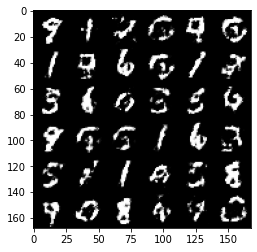

232, step: 109000, MeanDiscLoss: 0.5166006396412851, GenDiscLoss: 1.13741653931141


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


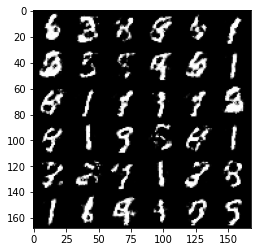

233, step: 109500, MeanDiscLoss: 0.5315196790695191, GenDiscLoss: 1.097916809201241


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


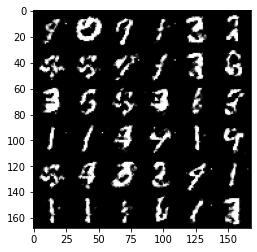

234, step: 110000, MeanDiscLoss: 0.5113776402473444, GenDiscLoss: 1.1052039173841472


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


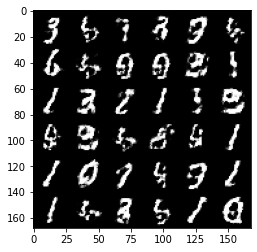

235, step: 110500, MeanDiscLoss: 0.5077102807760235, GenDiscLoss: 1.1446520240306846


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


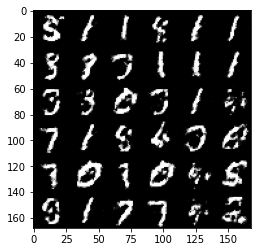

236, step: 111000, MeanDiscLoss: 0.5317049252986905, GenDiscLoss: 1.0795400018692016


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


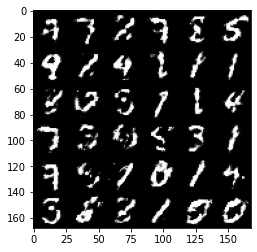

237, step: 111500, MeanDiscLoss: 0.5515339631438253, GenDiscLoss: 1.0180981374979028


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


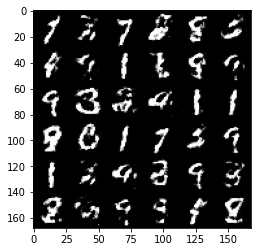

238, step: 112000, MeanDiscLoss: 0.5309049950838086, GenDiscLoss: 1.0528801110982902


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


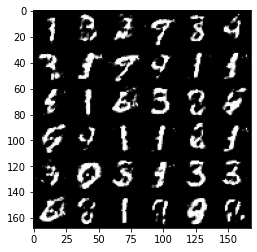

239, step: 112500, MeanDiscLoss: 0.543757294714451, GenDiscLoss: 1.0540757417678825


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


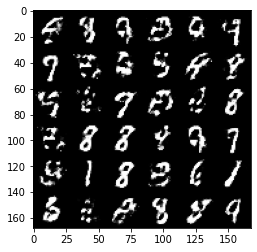

240, step: 113000, MeanDiscLoss: 0.5360657130479812, GenDiscLoss: 1.066345931053162


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


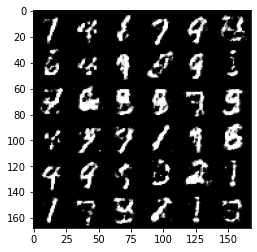

242, step: 113500, MeanDiscLoss: 0.5326322001814846, GenDiscLoss: 1.0657566007375718


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


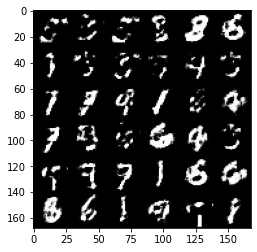

243, step: 114000, MeanDiscLoss: 0.5390534133315089, GenDiscLoss: 1.074640907526017


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


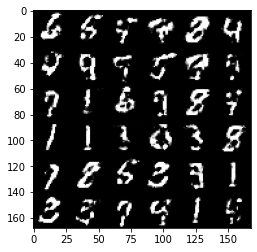

244, step: 114500, MeanDiscLoss: 0.5001756719350813, GenDiscLoss: 1.1405111978054048


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


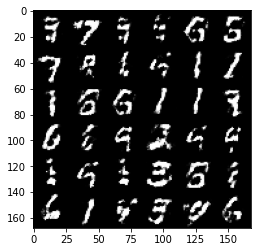

245, step: 115000, MeanDiscLoss: 0.5302523538470267, GenDiscLoss: 1.080938892841339


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


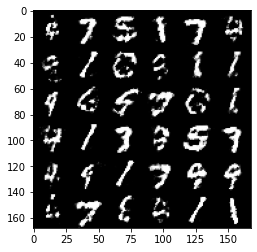

246, step: 115500, MeanDiscLoss: 0.5617109157443045, GenDiscLoss: 0.989105226755142


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


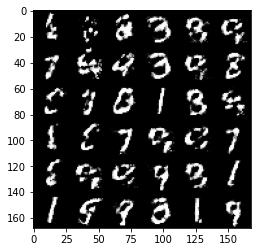

247, step: 116000, MeanDiscLoss: 0.5429749490618703, GenDiscLoss: 1.0393235925436022


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


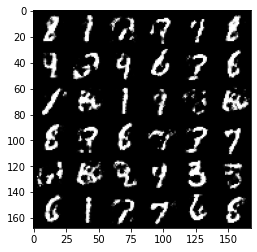

248, step: 116500, MeanDiscLoss: 0.5632898840308188, GenDiscLoss: 0.9932430578470227


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


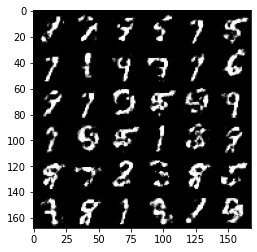

249, step: 117000, MeanDiscLoss: 0.5676974199414254, GenDiscLoss: 0.9868294615745548


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


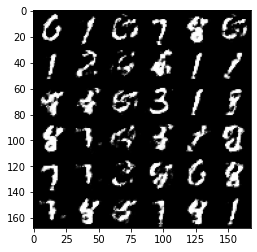

250, step: 117500, MeanDiscLoss: 0.5703658792972562, GenDiscLoss: 0.9845599595308301


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


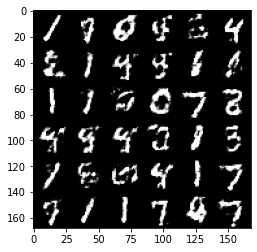

251, step: 118000, MeanDiscLoss: 0.5898374427556993, GenDiscLoss: 0.9538723182678218


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


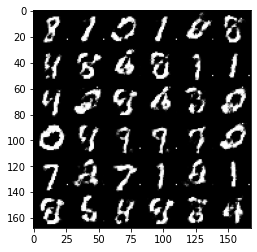

252, step: 118500, MeanDiscLoss: 0.7528359850049012, GenDiscLoss: 0.8328944872617722


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


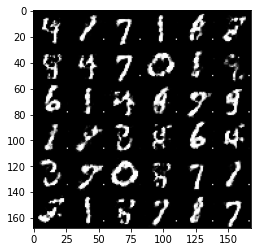

253, step: 119000, MeanDiscLoss: 0.8236362090110777, GenDiscLoss: 0.5633176553249362


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


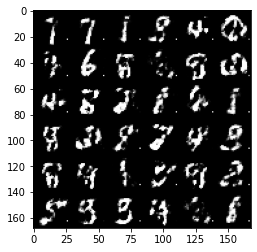

254, step: 119500, MeanDiscLoss: 0.748895347237587, GenDiscLoss: 0.5810500447750093


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


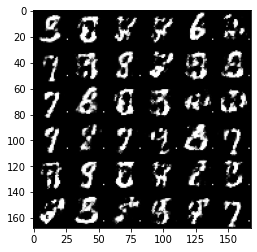

255, step: 120000, MeanDiscLoss: 0.688041677713394, GenDiscLoss: 0.6570787671804431


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


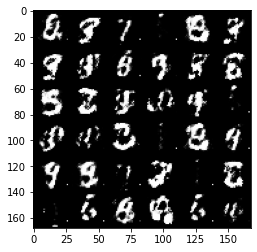

256, step: 120500, MeanDiscLoss: 0.6742235696315765, GenDiscLoss: 0.7053767039775847


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


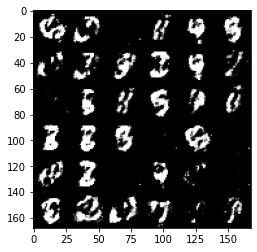

257, step: 121000, MeanDiscLoss: 0.6906999986171729, GenDiscLoss: 0.683134013652802


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


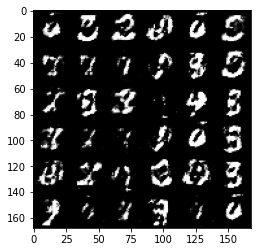

259, step: 121500, MeanDiscLoss: 0.6766613980531697, GenDiscLoss: 0.6982007371187208


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


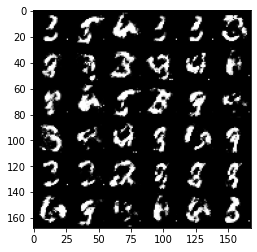

260, step: 122000, MeanDiscLoss: 0.6671106290817262, GenDiscLoss: 0.7263095186948774


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


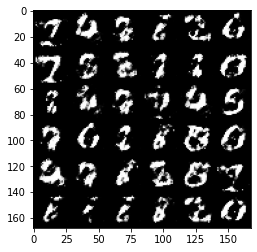

261, step: 122500, MeanDiscLoss: 0.6661036839485172, GenDiscLoss: 0.7135597982406617


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


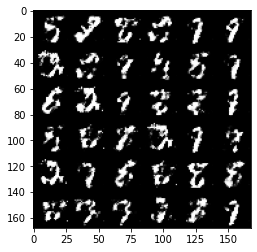

262, step: 123000, MeanDiscLoss: 0.6523146685361861, GenDiscLoss: 0.7441063078641889


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


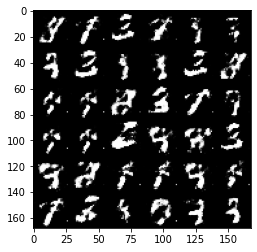

263, step: 123500, MeanDiscLoss: 0.6366062010526654, GenDiscLoss: 0.7799903510808942


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


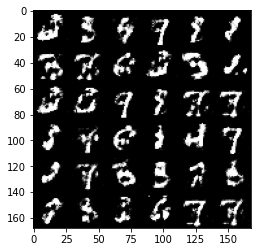

264, step: 124000, MeanDiscLoss: 0.6300824035406111, GenDiscLoss: 0.8073903226852417


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


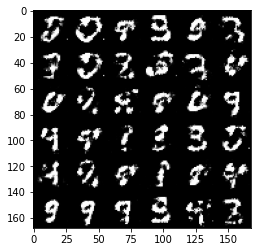

265, step: 124500, MeanDiscLoss: 0.5899935132265092, GenDiscLoss: 0.8940786908864969


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


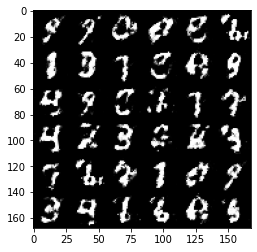

266, step: 125000, MeanDiscLoss: 0.5882759276628494, GenDiscLoss: 0.9112656109333038


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


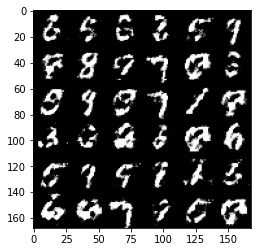

267, step: 125500, MeanDiscLoss: 0.5504001182913779, GenDiscLoss: 0.974189506411552


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


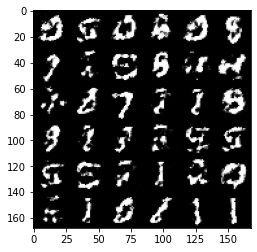

268, step: 126000, MeanDiscLoss: 0.5475804005265235, GenDiscLoss: 1.0086992349624633


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


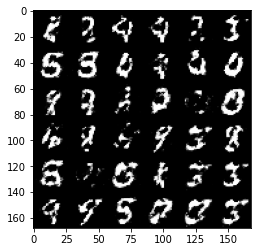

269, step: 126500, MeanDiscLoss: 0.5210397852063178, GenDiscLoss: 1.1197271227836607


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


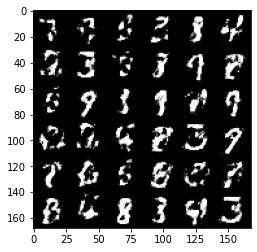

270, step: 127000, MeanDiscLoss: 0.44634738206863445, GenDiscLoss: 1.3595857703685763


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


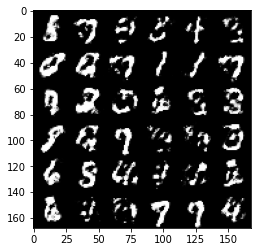

271, step: 127500, MeanDiscLoss: 0.4849854221940044, GenDiscLoss: 1.2460507352352128


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


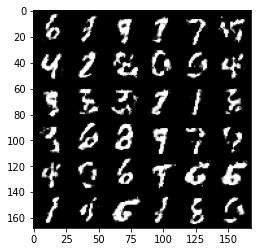

272, step: 128000, MeanDiscLoss: 0.5070827043056491, GenDiscLoss: 1.1713034987449635


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


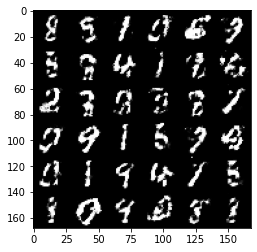

273, step: 128500, MeanDiscLoss: 0.5014410819411272, GenDiscLoss: 1.2323267853260045


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


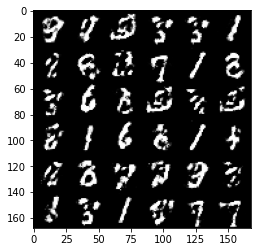

275, step: 129000, MeanDiscLoss: 0.5202339972853659, GenDiscLoss: 1.165398007392884


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


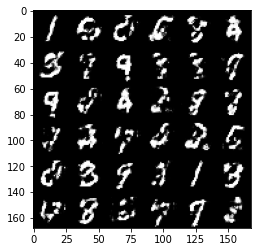

276, step: 129500, MeanDiscLoss: 0.5272917032837867, GenDiscLoss: 1.1017368724346162


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


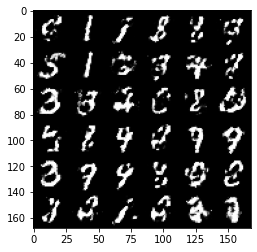

277, step: 130000, MeanDiscLoss: 0.5214899647235872, GenDiscLoss: 1.1266055959463108


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


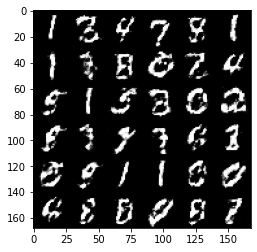

278, step: 130500, MeanDiscLoss: 0.55022465634346, GenDiscLoss: 1.0833111679553982


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


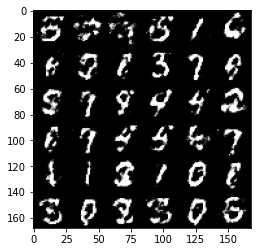

279, step: 131000, MeanDiscLoss: 0.5521849969029428, GenDiscLoss: 1.0183793888092048


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


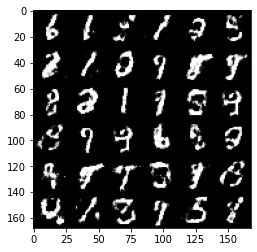

280, step: 131500, MeanDiscLoss: 0.5501755762696272, GenDiscLoss: 1.048161968469619


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


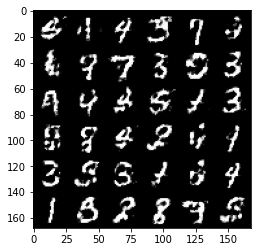

281, step: 132000, MeanDiscLoss: 0.5708031433820727, GenDiscLoss: 1.0175464667081824


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


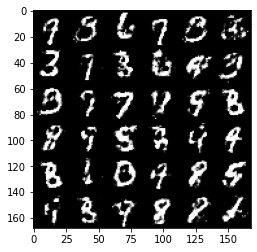

282, step: 132500, MeanDiscLoss: 0.5766081444025037, GenDiscLoss: 0.967175835013389


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


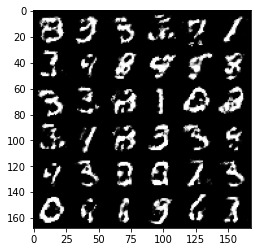

283, step: 133000, MeanDiscLoss: 0.5821541384458547, GenDiscLoss: 0.9625927978754037


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


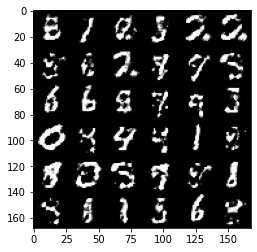

284, step: 133500, MeanDiscLoss: 0.585898584365845, GenDiscLoss: 0.9538834723234184


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


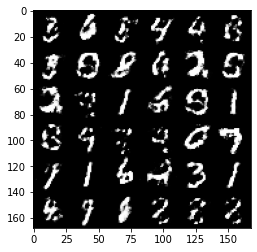

285, step: 134000, MeanDiscLoss: 0.5769465843439097, GenDiscLoss: 0.9519971723556517


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


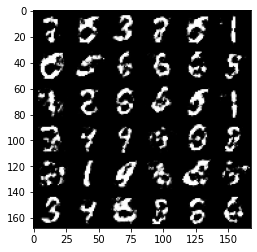

286, step: 134500, MeanDiscLoss: 0.5799577388763426, GenDiscLoss: 0.9363612678050989


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


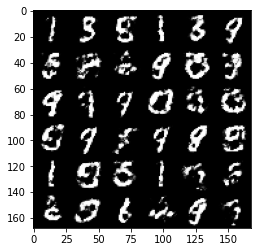

287, step: 135000, MeanDiscLoss: 0.5783794847130777, GenDiscLoss: 0.9855401241779326


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


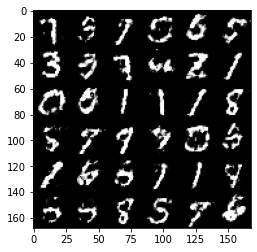

288, step: 135500, MeanDiscLoss: 0.5781283609867096, GenDiscLoss: 0.9796441705226898


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


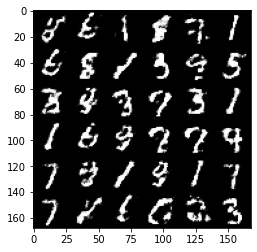

289, step: 136000, MeanDiscLoss: 0.5904655671119687, GenDiscLoss: 0.931037853002548


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


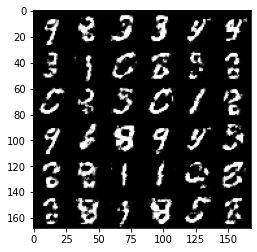

291, step: 136500, MeanDiscLoss: 0.5773731690049166, GenDiscLoss: 0.971817814946174


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


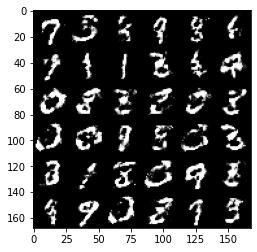

292, step: 137000, MeanDiscLoss: 0.548271046876907, GenDiscLoss: 1.035707471489907


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


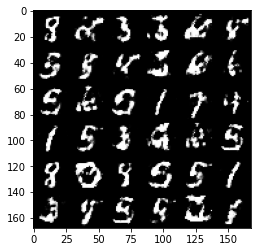

293, step: 137500, MeanDiscLoss: 0.5430871344208713, GenDiscLoss: 1.0591760250329987


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


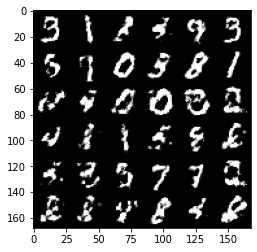

294, step: 138000, MeanDiscLoss: 0.5489136779308322, GenDiscLoss: 1.0460094084739668


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


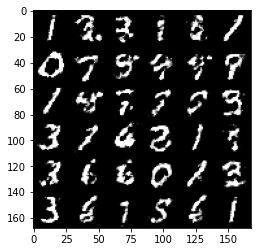

295, step: 138500, MeanDiscLoss: 0.5585385401844981, GenDiscLoss: 1.0014989383220676


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


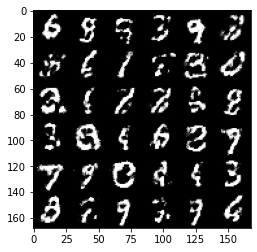

296, step: 139000, MeanDiscLoss: 0.5603768324851988, GenDiscLoss: 0.9931980516910554


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


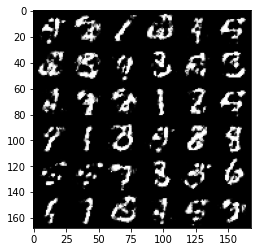

297, step: 139500, MeanDiscLoss: 0.5777502411603934, GenDiscLoss: 0.9403317309617987


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


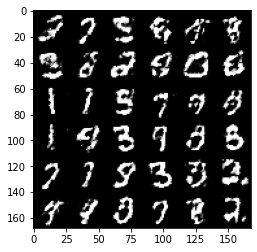

298, step: 140000, MeanDiscLoss: 0.5711529636383053, GenDiscLoss: 0.9856168423891069


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


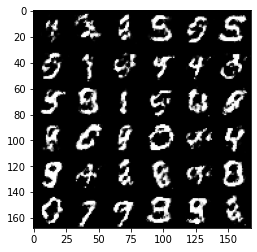

299, step: 140500, MeanDiscLoss: 0.5652224589586258, GenDiscLoss: 0.9980844089984898


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


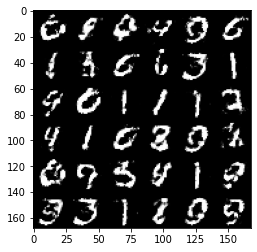

300, step: 141000, MeanDiscLoss: 0.6074173419475559, GenDiscLoss: 0.9393374713659285


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


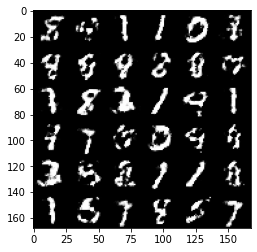

301, step: 141500, MeanDiscLoss: 0.5813116995692258, GenDiscLoss: 0.9829868249893191


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


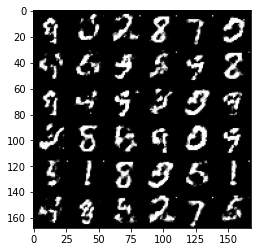

302, step: 142000, MeanDiscLoss: 0.6877662163972855, GenDiscLoss: 0.8260785566568384


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


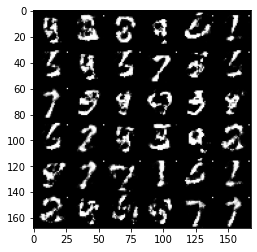

303, step: 142500, MeanDiscLoss: 0.7009561343193049, GenDiscLoss: 0.6673124990463254


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


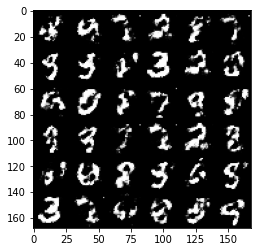

304, step: 143000, MeanDiscLoss: 0.6383603794574738, GenDiscLoss: 0.7520117456912997


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


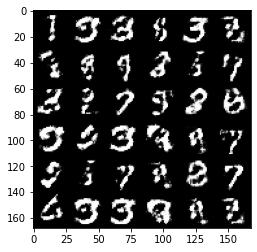

305, step: 143500, MeanDiscLoss: 0.6672841576337816, GenDiscLoss: 0.7171100900173193


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


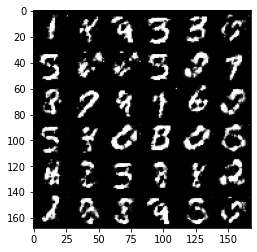

307, step: 144000, MeanDiscLoss: 0.6440659806728358, GenDiscLoss: 0.7613775297403336


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


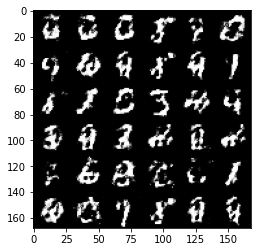

308, step: 144500, MeanDiscLoss: 0.670582120537758, GenDiscLoss: 0.7481568171978003


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


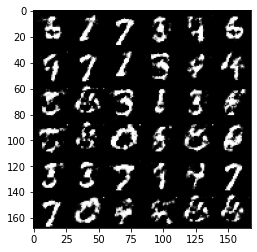

309, step: 145000, MeanDiscLoss: 0.6593332427740103, GenDiscLoss: 0.7426724737882618


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


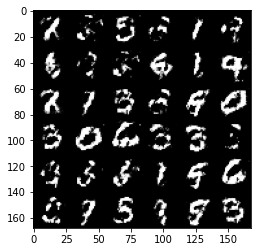

310, step: 145500, MeanDiscLoss: 0.6495344188213349, GenDiscLoss: 0.7635999290943138


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


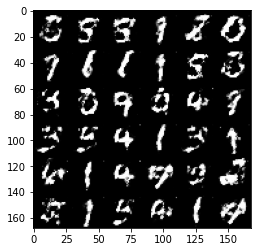

311, step: 146000, MeanDiscLoss: 0.63830912744999, GenDiscLoss: 0.8012773784399035


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


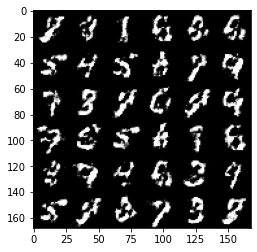

312, step: 146500, MeanDiscLoss: 0.6187161766290663, GenDiscLoss: 0.8110476210117337


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


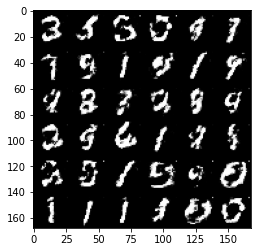

313, step: 147000, MeanDiscLoss: 0.6102098482847215, GenDiscLoss: 0.8568787571191785


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


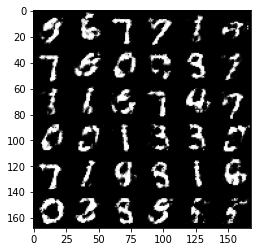

314, step: 147500, MeanDiscLoss: 0.605137750029564, GenDiscLoss: 0.8836617119312286


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


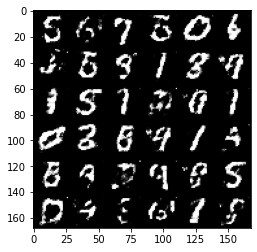

315, step: 148000, MeanDiscLoss: 0.5765208046436316, GenDiscLoss: 0.9533241213560109


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


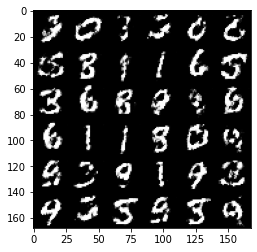

316, step: 148500, MeanDiscLoss: 0.5799791454076766, GenDiscLoss: 0.9558969746828068


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


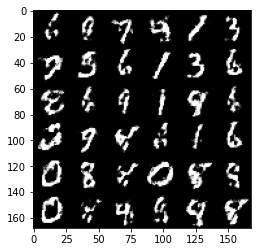

317, step: 149000, MeanDiscLoss: 0.5839801867008212, GenDiscLoss: 0.9497627125978471


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


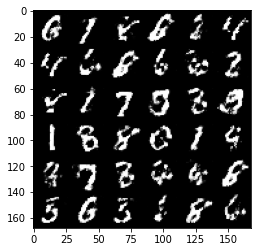

318, step: 149500, MeanDiscLoss: 0.5814010950326917, GenDiscLoss: 1.0073162508010864


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


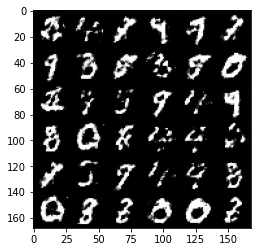

319, step: 150000, MeanDiscLoss: 0.5887962725162506, GenDiscLoss: 0.9906007488965992


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


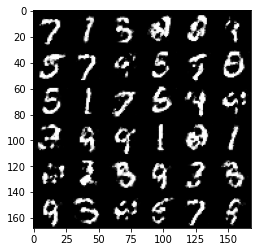

320, step: 150500, MeanDiscLoss: 0.5428945415019989, GenDiscLoss: 1.0621163856983191


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


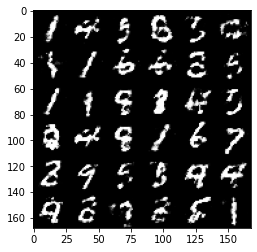

321, step: 151000, MeanDiscLoss: 0.5654061172604566, GenDiscLoss: 1.071538540959358


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


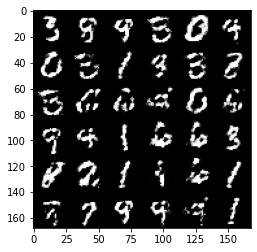

323, step: 151500, MeanDiscLoss: 0.5670880094766616, GenDiscLoss: 1.0486268028020862


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


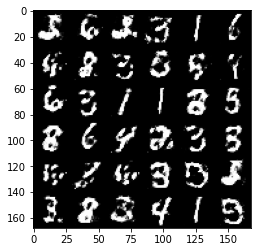

324, step: 152000, MeanDiscLoss: 0.532032919228077, GenDiscLoss: 1.1106676665544515


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


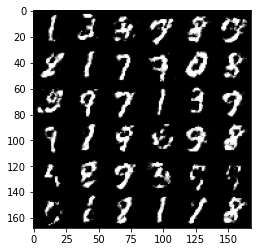

325, step: 152500, MeanDiscLoss: 0.5792604712247847, GenDiscLoss: 0.984083593964576


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


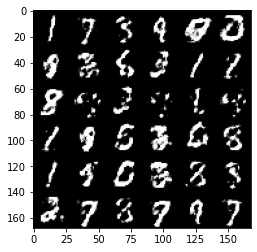

326, step: 153000, MeanDiscLoss: 0.56142606651783, GenDiscLoss: 1.0027659645080562


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


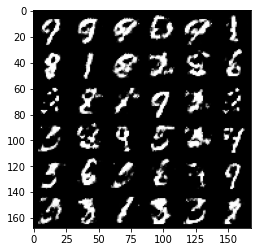

327, step: 153500, MeanDiscLoss: 0.5386172779798499, GenDiscLoss: 1.0854808160066607


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


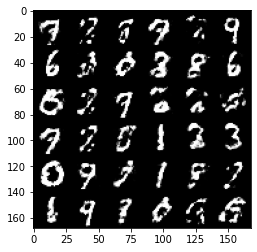

328, step: 154000, MeanDiscLoss: 0.5514030866026876, GenDiscLoss: 1.0791028786897647


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


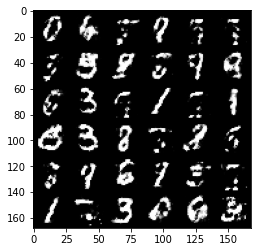

329, step: 154500, MeanDiscLoss: 0.5744917489290237, GenDiscLoss: 1.0162015221118923


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


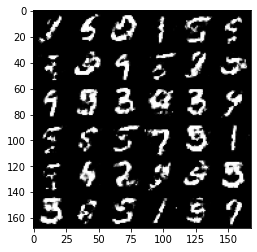

330, step: 155000, MeanDiscLoss: 0.5835485292673112, GenDiscLoss: 0.9695875202417371


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


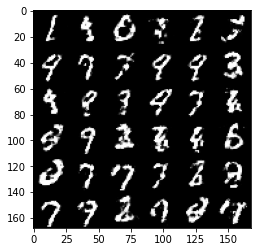

331, step: 155500, MeanDiscLoss: 0.5825191360712053, GenDiscLoss: 0.984130797028542


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


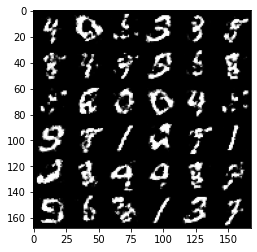

332, step: 156000, MeanDiscLoss: 0.5711227245330813, GenDiscLoss: 0.9878063671588899


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


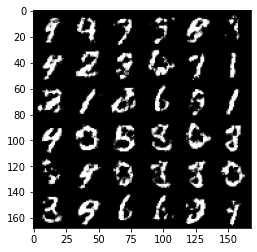

333, step: 156500, MeanDiscLoss: 0.5760159905552866, GenDiscLoss: 1.0050973935127263


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


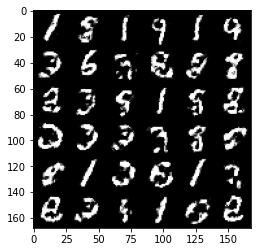

334, step: 157000, MeanDiscLoss: 0.5783912596702571, GenDiscLoss: 0.9822301495075221


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


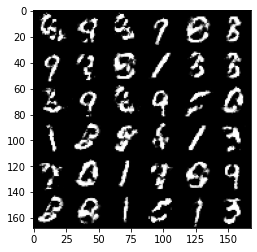

335, step: 157500, MeanDiscLoss: 0.5810742044448856, GenDiscLoss: 0.9705825619697571


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


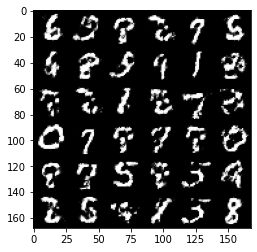

336, step: 158000, MeanDiscLoss: 0.5818668363094331, GenDiscLoss: 0.9834761004447935


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


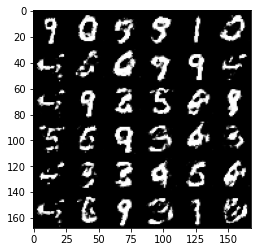

337, step: 158500, MeanDiscLoss: 0.5818367090821273, GenDiscLoss: 1.0161845551729196


  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


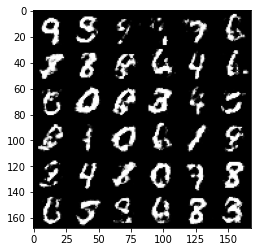

339, step: 159000, MeanDiscLoss: 0.5649889810085298, GenDiscLoss: 1.0194306083917615


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


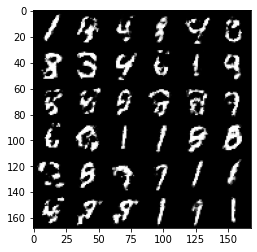

340, step: 159500, MeanDiscLoss: 0.5746349909305568, GenDiscLoss: 0.9763445008993151


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


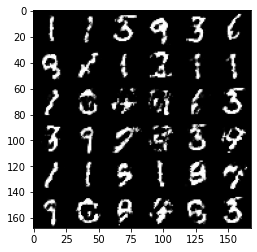

341, step: 160000, MeanDiscLoss: 0.5916288757324212, GenDiscLoss: 0.9532506203651433


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


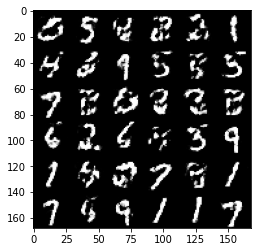

342, step: 160500, MeanDiscLoss: 0.5783167979717252, GenDiscLoss: 0.9693073172569275


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


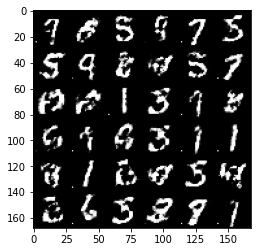

343, step: 161000, MeanDiscLoss: 0.6873306812047955, GenDiscLoss: 0.8330143489837646


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


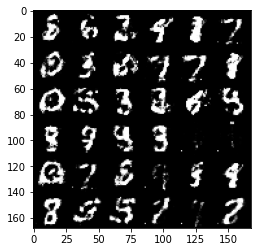

344, step: 161500, MeanDiscLoss: 0.6587137372493744, GenDiscLoss: 0.7380964181423186


  0%|          | 0/469 [00:00<?, ?it/s]

torch.Size([128, 1, 28, 28]) torch.Size([168, 168, 3])


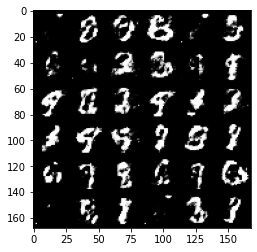

345, step: 162000, MeanDiscLoss: 0.69892655980587, GenDiscLoss: 0.7138965358734136


In [37]:
gan = ganClass(zDim=ZDIM,hiddenGenDim=128,inputDiscDim=784).to(DEVICE)
gan.fit(zDim=ZDIM)